<img src="http://s3.amazonaws.com/pix.iemoji.com/images/emoji/apple/ios-12/256/waving-hand.png" align=left width=44, heigth=44>
<div class="alert alert-info">
<b> Комментарий ревьюера</b>


Привет, Алексей! Давай знакомиться! Меня зовут Дмитрий Махортов, и я буду проверять твой проект. Сразу предлагаю общение на «ты» 🙂, но если тебе это не комфортно, то дай знать, и мы перейдем на «вы».


Моя основная цель — не указать на совершенные тобою ошибки, а поделиться своим опытом и помочь тебе погрузиться в увлекательный мир работы с данными и вырасти в крепкого профи. Это отдаленная цель. А ближайшая - сделать твою работу еще лучше )).
   
    
Все ключевые этапы в работе выполнены, и я вижу что с проектом ты справшяешься. Есть моменты, которые нужно доработать, но я уверен, у тебя все получится.
        
Расскажу как обычно проходит проверка:    
Бывают моменты, которые требуют пристального внимания. Комментарии по ним выделены <span style='background-color:#F7B3A4'> красным цветом </span> и обозначены значком 🛑. После их доработки проект будет принят.  🙂

<span style='background-color:#B7EBA7'> Зеленым цветом </span> и значком ✅ отмечены удачные и элегантные решения, на которые можно опираться в будущих проектах. Или советы «со звездочкой», которые помогут тебе в будущем.

<span style='background-color:#F9EDA6'>Жёлтым цветом </span> и значком ⚠️ выделено то, что в следующий раз можно сделать по-другому. Ты можешь учесть эти комментарии при выполнении будущих заданий или доработать проект сейчас (однако это не обязательно).

Давай работать над проектом в диалоге: **если ты что-то меняешь в проекте по моим рекомендациям — пиши об этом**. Выбери для своих комментариев какой-то заметный цвет, так мне будет легче отследить изменения. Пожалуйста, **не перемещай, не изменяй и не удаляй мои комментарии**. Всё это поможет выполнить повторную проверку твоего проекта оперативнее.
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>образец комментария студента</b></font>
   
Можешь использовать этот комментарий. Просто удали этот текст и вместо него напиши свой 🙂

</div>

# Проект: Поиск изображений по текстовому запросу

**Заказчик:**
Фотохостинг для профессиональных фотографов “With Sense”

**Цель проекта:**
Разработка демонстрационной версии модели для поиска референсных фотографий на основе текстового запроса.

**Цель исследования:**
Доказать техническую осуществимость модели поиска изображений по текстовым описаниям (Proof of Concept) для дальнейшей интеграции в сервис.

**Задачи проекта:**
1. Провести исследовательский анализ данных.
2. Подготовить данные для обучения модели.
3. Провести векторизацию текстов и изображений.
4. Обучить модели для предсказания соответствия текста и изображения.
5. Тестировать лучшую модель на тестовых данных.
6. Сделать общий вывод по результатам.

**Ход исследования:**
**Шаг 1: Загрузка и подготовка данных:** Загрузка данных (файлы train_dataset.csv, CrowdAnnotations.tsv, ExpertAnnotations.tsv)

**Описание данных:**
1. **train_dataset.csv**: содержит имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат `<имя файла изображения>#<порядковый номер описания>`.


2. **CrowdAnnotations.tsv**: данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Содержит следующие поля:
   - Имя файла изображения.
   - Идентификатор описания.
   - Доля людей, подтвердивших соответствие описания изображению.
   - Количество человек, подтвердивших соответствие.
   - Количество человек, не подтвердивших соответствие.


3. **ExpertAnnotations.tsv**: данные по соответствию изображения и описания от экспертов. Поля:
   - Имя файла изображения.
   - Идентификатор описания.
   - Оценки трёх экспертов по шкале от 1 до 4:
     - 1 — не соответствует.
     - 2 — частичное соответствие.
     - 3 — соответствие с незначительными отклонениями.
     - 4 — полное соответствие.


4. **test_queries.csv**: данные для тестирования. Поля:
   - Идентификатор запроса.
   - Текст запроса.
   - Релевантное изображение. Для одной картинки может быть доступно до 5 описаний.


5. **train_images**: папка с изображениями для обучения модели.


6. **test_images**: папка с изображениями для тестирования модели.

Данные доступны по [ссылке](https://code.s3.yandex.net/datasets/dsplus_integrated_project_4.zip).

**Шаг 2: Исследовательский анализ данных**
- Проверка на наличие пропущений, необходимости очистки данных.
- Агрегация оценок экспертов.
- Объединение данных краудсорсинга и экспертов.

**Описание данных:**
Датасет содержит экспертные и краудсорсинговые оценки соответствия текста и изображения.

В файле с экспертными мнениями для каждой пары изображение-текст имеются оценки от трёх специалистов. Для решения задачи эти оценки необходимов агрегировать — превратить в одну. Существует несколько способов агрегации оценок, самый простой — голосование большинства: за какую оценку проголосовала большая часть экспертов (в нашем случае 2 или 3), та оценка и ставится как итоговая. Поскольку число экспертов меньше числа классов, может случиться, что каждый эксперт поставит разные оценки, например: 1, 4, 2. В таком случае данную пару изображение-текст можно исключить из датасета.

В файле с краудсорсинговыми оценками информация расположена в таком порядке:
1. Доля исполнителей, подтвердивших, что текст **соответствует** картинке.
2. Количество исполнителей, подтвердивших, что текст **соответствует** картинке.
3. Количество исполнителей, подтвердивших, что текст **не соответствует** картинке.

Модель должна возвращать на выходе вероятность соответствия изображения тексту, поэтому целевая переменная должна иметь значения от 0 до 1.


**Шаг 3: Подготовка данных**
- Формирование списка неподобающих слов.
- Очистка данных от юридически вредного контента.

**Примечаине:**
В некоторых странах, где работает компания, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно тексты, изображения, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16 лет.

В сервисе строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер:

> This image is unavailable in your country in compliance with local laws
>

Однако в PoC нет возможности воспользоваться данным функционалом. Поэтому все изображения, которые нарушают данный закон, нужно удалить из обучающей выборки.

**Шаг 4: Векторизация данных**
- Векторизация изображений (модель ResNet50).
- Векторизация текстов (методы TF-IDF, word2vec, BERT).

**Шаг 5: Обучение модели**
- Выбор метрик оценки.
- Обучение линейной регрессии и нейронных сетей.

**Шаг 6: Тестирование и демонстрация**
- Тестирование модели на тестовых данных.
- Реализация функции поиска.
- Проверка результатов на примерах.

**Выводы**
- Описание лучшей модели.
- Анализ ошибок модели.
- Оценка практической реализуемости.

## Загрузка и первичны обзор данных

### Импорт библиотек и настройка графиков

In [1]:
%pip install -q "dask[dataframe]"
%pip install -q --upgrade tensorflow

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Лично меня очень утомляют простыни логов после установки библиотек. И как правило, их все равно никто не читает. Можно добавить флаг -q , будет гораздо аккуратноее.
    
    !pip install -q transformers
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Ты прав, обычно я так и делаю, тут был долгий процесс отладки и просто не углядел, что нужно от них избавиться при итоговой прогонке. И да проект в итоге перенесс в Colab.
    
    Замечание исправлено!

</div>


<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Кстати, а зачем transformers? насколько я понимаю для векторизации текстов ты использовал конкурирующую библиотеку keras_nlp?  Не стоит тянуть в проект слишком много зависимостей и тем более не нужно ставить библиотеки, которые в проекте не используются.
    
    
    
    
    
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Да ты прав, это отголоски предыдущих подходов к решению проекта.

</div>

In [2]:
# ====================================================
# 📌 СИСТЕМНЫЕ БИБЛИОТЕКИ
# ====================================================
import os
import sys
import time
import random
import re
import zipfile
import io
import glob
import requests
import warnings
from pathlib import Path
from io import BytesIO

# ====================================================
# 📌 РАБОТА С МАССИВАМИ И ТАБЛИЦАМИ
# ====================================================
import numpy as np
import pandas as pd

# ====================================================
# 📌 РАБОТА С ИЗОБРАЖЕНИЯМИ
# ====================================================
from PIL import Image, ImageOps

# ====================================================
# 📌 МАШИННОЕ ОБУЧЕНИЕ (СКЛАДСКИЙ АНАЛИЗ ДАННЫХ)
# ====================================================
import sklearn
from sklearn.linear_model import Ridge, LogisticRegression
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.model_selection import (
    GridSearchCV, cross_val_score, train_test_split,
    GroupShuffleSplit, KFold
)
from sklearn.metrics import (
    recall_score, root_mean_squared_error, precision_score,
    make_scorer, accuracy_score
)
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.dummy import DummyClassifier, DummyRegressor
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

# ====================================================
# 📌 ГЛУБОКОЕ ОБУЧЕНИЕ (TensorFlow / Keras)
# ====================================================
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import (
    Dense, Flatten, GlobalAveragePooling2D, Conv2D, MaxPooling2D,
    BatchNormalization, Reshape, RepeatVector, LSTM, Dropout
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import RootMeanSquaredError
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet import ResNet50
from keras.applications.resnet50 import preprocess_input

import torch

# ====================================================
# 📌 ОБРАБОТКА ЕСТЕСТВЕННОГО ЯЗЫКА (NLP)
# ====================================================
import nltk
from nltk import pos_tag
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords, wordnet
from nltk.stem import WordNetLemmatizer
import pymystem3
from pymystem3 import Mystem

# ====================================================
# 📌 ТРАНСФОРМЕРЫ (BERT / Sentence Transformers)
# ====================================================
import transformers
import keras_nlp
from transformers import BertTokenizer, BertModel
from sentence_transformers import SentenceTransformer, util

# ====================================================
# 📌 ВИЗУАЛИЗАЦИЯ ДАННЫХ
# ====================================================
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from tqdm import notebook
tqdm.pandas()

# ====================================================
# 📌 НАСТРОЙКИ И КОНСТАНТЫ
# ====================================================
warnings.filterwarnings("ignore", category=UserWarning, module="matplotlib")
warnings.filterwarnings("ignore")
pd.set_option('display.max_columns', None)

# Загрузка ресурсов NLTK
import nltk
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('omw-1.4')
nltk.download('averaged_perceptron_tagger_eng')
nltk.download('punkt_tab')

# Константы
RANDOM_STATE = 42
random.seed(RANDOM_STATE)
np.random.seed(RANDOM_STATE)
tf.random.set_seed(RANDOM_STATE)

# Вывод пути интерпретатора Python
print("Python Interpreter Path:", sys.executable)

Python Interpreter Path: /usr/bin/python3


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger_eng is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Отлично, все нужные библиотеки импортированы в начале ноутбука.Это хорошая практика.</div>

In [3]:
sys.path.append('/home/jupyter/.local/lib/python3.10/site-packages')
print(sklearn.__version__)
print(transformers.__version__)
print(os.getcwd())

1.6.1
4.48.2
/content


### Используемые функции

In [4]:
def download_and_extract_zip(url, extract_to):
    """
    Функция скачивает ZIP-архив по ссылке и распаковывает его в указанную директорию.
    """
    try:
        response = requests.get(url, stream=True)
        response.raise_for_status()

        with zipfile.ZipFile(io.BytesIO(response.content)) as zip_ref:
            zip_ref.extractall(extract_to)

        print(f"Архив успешно загружен и распакован в {extract_to}")
    except Exception as e:
        print(f"Ошибка загрузки или распаковки: {str(e)}")

In [5]:
# Функция для загрузки данных
def load_data(local_file_path, remote_url, sep=',', decimal='.', date_columns=None, index_col=None, names=None):
    try:
        # Проверяем, существует ли локальный файл
        if os.path.exists(local_file_path):
            print(f'Загрузка данных из локального файла: {local_file_path}')
            return pd.read_csv(
                local_file_path,
                sep=sep,
                names=names,
                decimal=decimal,
                parse_dates=date_columns if date_columns else False,  # Указываем parse_dates только при необходимости
                index_col=index_col
            )
        else:
            print(f'Загрузка данных из удаленного источника: {remote_url}')
            return pd.read_csv(
                remote_url,
                sep=sep,
                names=names,
                decimal=decimal,
                parse_dates=date_columns if date_columns else False,  # Указываем parse_dates только при необходимости
                index_col=index_col
            )
    except Exception as e:
        # Если произошла ошибка, выводим сообщение
        print('Загрузка произошла с ошибкой')
        print(f'Ошибка: {str(e)}')
        return None

In [6]:
def data_overview(df, text_column, plot=True):
    """
    Функция для первичного обзора данных DataFrame.

    Параметры:
    - df: pandas DataFrame
    - target_column: Название колонки с целевой переменной.
    - text_column: Название колонки с текстовыми данными.
    """
    data = df.copy()

    print("Первые 5 строк данных:")
    display(data.head())

    print("\nОбщая информация о данных:")
    display(data.info())

    print("\nОписание числовых данных:")
    display(data.describe())

    print("\nКоличество пропущенных значений:")
    display(data.isnull().sum())

    print("\nКоличество уникальных значений в каждом столбце:")
    display(data.nunique())

    # Проверка дубликатов
    duplicate_count = data.duplicated().sum()
    print(f"\nКоличество дубликатов: {duplicate_count}")
    if duplicate_count > 0:
        print("Примеры дубликатов:")
        display(data[data.duplicated()].head())

    if plot:
      # Вычисление длины текста
      data['text_length'] = data[text_column].str.strip().str.len()
      print(f"\nМаксимальное количество символов в '{text_column}' (без лишних пробелов): {data['text_length'].max()}")
      print(f"Минимальное количество символов в '{text_column}' (без лишних пробелов): {data['text_length'].min()}")

      # Построение графика длины текста
      plt.figure(figsize=(12, 6))
      sns.histplot(data['text_length'], kde=True, color='blue')
      plt.title("Распределение длины текста")
      plt.xlabel("Количество символов")
      plt.ylabel("Частота")
      plt.show()

      # Вычисление количества слов
      data['word_count'] = data[text_column].str.strip().str.split().apply(len)
      print(f"\nКоличество слов в '{text_column}':")
      print(f"Максимум: {data['word_count'].max()}")
      print(f"Минимум: {data['word_count'].min()}")
      print(f"Среднее: {data['word_count'].mean():.2f}")
      print(f"Медиана: {data['word_count'].median()}")

      # Построение графика распределения количества слов
      plt.figure(figsize=(12, 6))
      sns.histplot(data['word_count'], kde=True, color='green')
      plt.title("Распределение количества слов в тексте")
      plt.xlabel("Количество слов")
      plt.ylabel("Частота")
      plt.show()

    return


In [7]:
def hash_image(image):
    return hashlib.md5(image.tobytes()).hexdigest()

### Загрузка данных

In [8]:
# URL с архивом изображений
zip_url = "https://code.s3.yandex.net/datasets/dsplus_integrated_project_4.zip"

# Локальная директория для распаковки
extract_path = "/content"

url_train_dataset = 'https://raw.githubusercontent.com/Alexey-Khalimov/Image_Search/refs/heads/main/datasets/train_dataset.csv'
url_test_images = 'https://raw.githubusercontent.com/Alexey-Khalimov/Image_Search/refs/heads/main/datasets/test_images.csv'
url_test_queries = 'https://raw.githubusercontent.com/Alexey-Khalimov/Image_Search/refs/heads/main/datasets/test_queries.csv'
url_CrowdAnnotations = 'https://raw.githubusercontent.com/Alexey-Khalimov/Image_Search/refs/heads/main/datasets/CrowdAnnotations.tsv'
url_ExpertAnnotations = 'https://raw.githubusercontent.com/Alexey-Khalimov/Image_Search/refs/heads/main/datasets/ExpertAnnotations.tsv'

local_file_path_train_dataset = '/content/to_upload/train_dataset.csv'
local_file_path_test_images = '/content/to_upload/test_images.csv'
local_file_path_test_queries = '/content/to_upload/test_queries.csv'
local_file_path_CrowdAnnotations = '/content/to_upload/CrowdAnnotations.tsv'
local_file_path_ExpertAnnotations = '/content/to_upload/ExpertAnnotations.tsv'

test_images_dir = "/content/to_upload/test_images/"
train_images_dir = "/content/to_upload/train_images/"

test_images_target = "/content/to_upload/resized_test_images/"
train_images_target = "/content/to_upload/resized_train_images/"

In [9]:
# Загружаем и распаковываем архив
download_and_extract_zip(zip_url, extract_path)

# Загрузка данных
df_train_dataset = load_data(
    local_file_path=local_file_path_train_dataset,
    remote_url=url_train_dataset
    )

df_test_images = load_data(
    local_file_path=local_file_path_test_images,
    remote_url=url_test_images
    )

df_test_queries = load_data(
    local_file_path=local_file_path_test_queries,
    remote_url=url_test_queries,
    sep='|',
    index_col=[0]
    )

df_crowd_annot = load_data(
    local_file_path=local_file_path_CrowdAnnotations,
    remote_url=url_CrowdAnnotations,
    sep='\t',
    names = ['image', 'query_id', 'fraction', 'pros', 'cons']
    )

df_expert_annot = load_data(
    local_file_path=local_file_path_ExpertAnnotations,
    remote_url=url_ExpertAnnotations,
    sep='\t',
    names = ['image', 'query_id', 'expert_1', 'expert_2', 'expert_3']
    )

Архив успешно загружен и распакован в /content
Загрузка данных из локального файла: /content/to_upload/train_dataset.csv
Загрузка данных из локального файла: /content/to_upload/test_images.csv
Загрузка данных из локального файла: /content/to_upload/test_queries.csv
Загрузка данных из локального файла: /content/to_upload/CrowdAnnotations.tsv
Загрузка данных из локального файла: /content/to_upload/ExpertAnnotations.tsv


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Ого, я вижу ты даже решил проблему с загрузкой архива с датасетом из облака.  С точки зрения "попрактиковаться" это конечно же очень хорошо, но на практике я бы просто скачал и распаковал руками (или исползуя простой bash-script), вместо написания сложного кода.



</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Это первая моя работа на Colab, и поэтому я как то не сразу понял как ручками туда закинуть (и тем более не очень хотел и разбираться, сразу решил качать из облака), и вот пришлось изобретать бубен.)

</div>

### Первичный обзор

Первые 5 строк данных:


,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...



Общая информация о данных:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


None


Описание числовых данных:


,image,query_id,query_text
count,5822,5822,5822
unique,1000,977,977
top,3107513635_fe8a21f148.jpg,2600867924_cd502fc911.jpg#2,"Two dogs , one brown and white and one black a..."
freq,10,34,34



Количество пропущенных значений:


,0
image,0
query_id,0
query_text,0



Количество уникальных значений в каждом столбце:


,0
image,1000
query_id,977
query_text,977



Количество дубликатов: 0

Максимальное количество символов в 'query_text' (без лишних пробелов): 153
Минимальное количество символов в 'query_text' (без лишних пробелов): 11


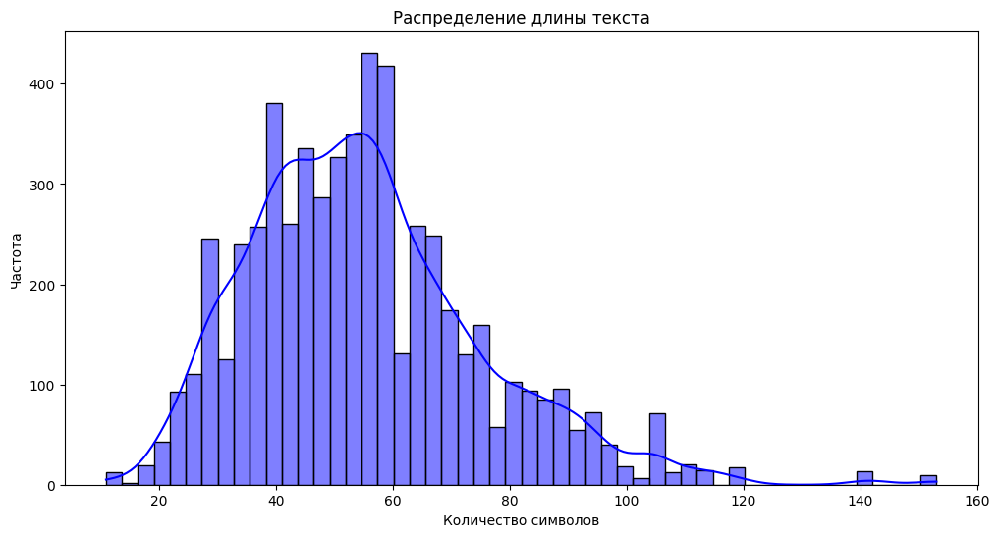


Количество слов в 'query_text':
Максимум: 34
Минимум: 2
Среднее: 11.90
Медиана: 11.0


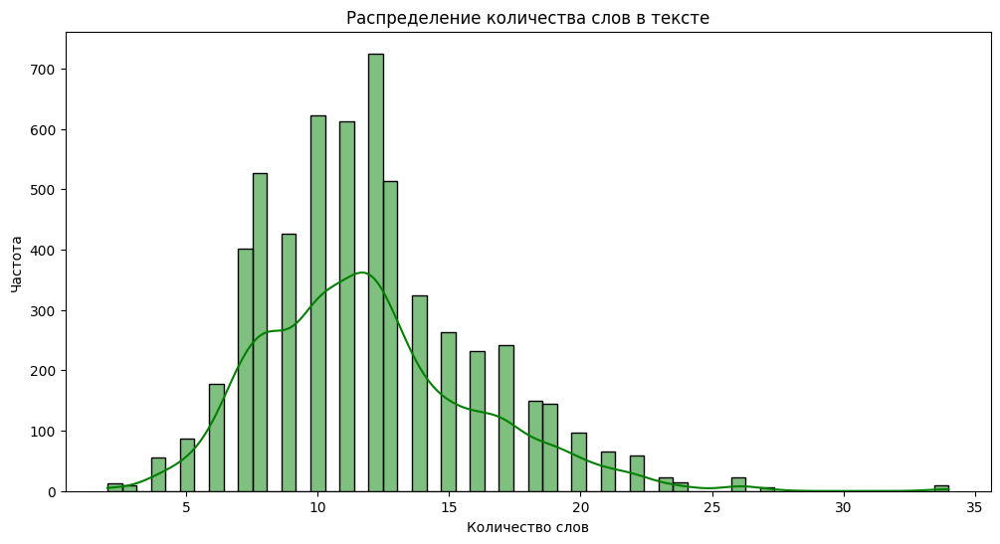

In [10]:
data_overview(
    df=df_train_dataset,
    text_column='query_text'
)

In [11]:
data_overview(
    df=df_test_images,
    text_column='image',
    plot=False
)

Первые 5 строк данных:


,image
0,3356748019_2251399314.jpg
1,2887171449_f54a2b9f39.jpg
2,3089107423_81a24eaf18.jpg
3,1429546659_44cb09cbe2.jpg
4,1177994172_10d143cb8d.jpg



Общая информация о данных:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   100 non-null    object
dtypes: object(1)
memory usage: 932.0+ bytes


None


Описание числовых данных:


,image
count,100
unique,100
top,2346402952_e47d0065b6.jpg
freq,1



Количество пропущенных значений:


,0
image,0



Количество уникальных значений в каждом столбце:


,0
image,100



Количество дубликатов: 0


Первые 5 строк данных:


,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg



Общая информация о данных:
<class 'pandas.core.frame.DataFrame'>
Index: 500 entries, 0 to 499
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   query_id    500 non-null    object
 1   query_text  500 non-null    object
 2   image       500 non-null    object
dtypes: object(3)
memory usage: 15.6+ KB


None


Описание числовых данных:


,query_id,query_text,image
count,500,500,500
unique,500,500,100
top,989851184_9ef368e520.jpg#4,The black dog has a toy in its mouth and a per...,989851184_9ef368e520.jpg
freq,1,1,5



Количество пропущенных значений:


,0
query_id,0
query_text,0
image,0



Количество уникальных значений в каждом столбце:


,0
query_id,500
query_text,500
image,100



Количество дубликатов: 0

Максимальное количество символов в 'query_text' (без лишних пробелов): 135
Минимальное количество символов в 'query_text' (без лишних пробелов): 19


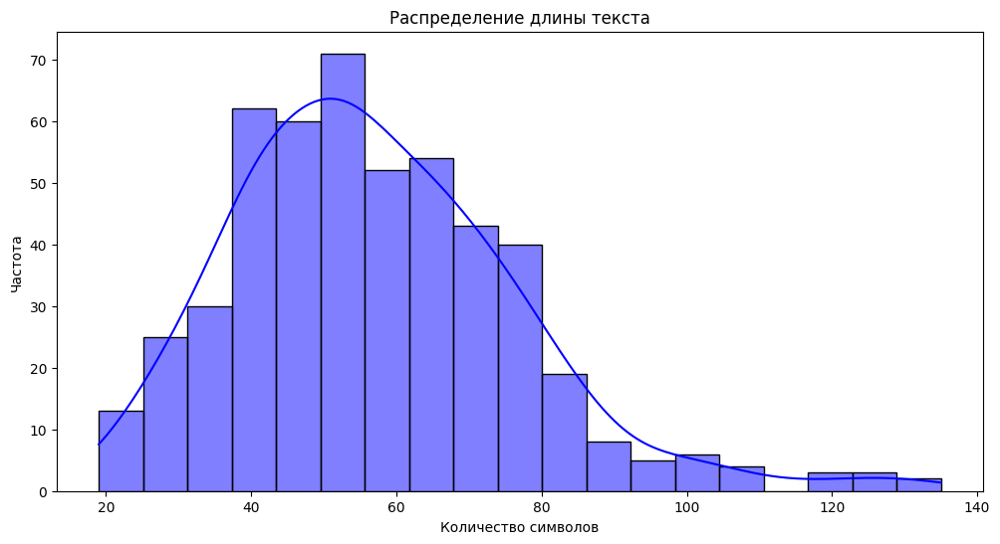


Количество слов в 'query_text':
Максимум: 31
Минимум: 4
Среднее: 12.20
Медиана: 12.0


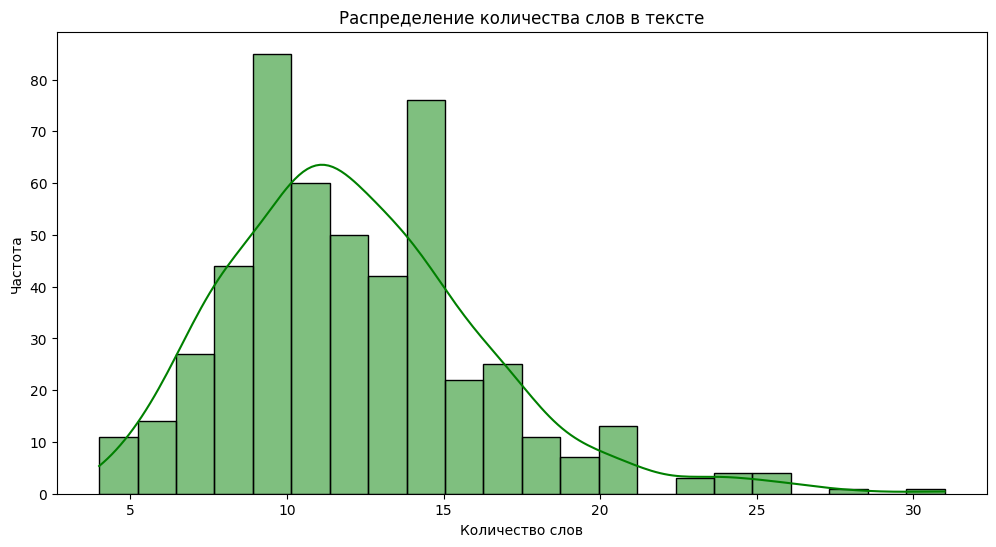

In [12]:
data_overview(
    df=df_test_queries,
    text_column='query_text'
)

Первые 5 строк данных:


,image,query_id,fraction,pros,cons
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3



Общая информация о данных:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   image     47830 non-null  object 
 1   query_id  47830 non-null  object 
 2   fraction  47830 non-null  float64
 3   pros      47830 non-null  int64  
 4   cons      47830 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


None


Описание числовых данных:


,fraction,pros,cons
count,47830.000000,47830.000000,47830.000000
mean,0.068786,0.208488,2.820155
std,0.207532,0.628898,0.656676
min,0.000000,0.000000,0.000000
25%,0.000000,0.000000,3.000000
50%,0.000000,0.000000,3.000000
75%,0.000000,0.000000,3.000000
max,1.000000,5.000000,6.000000



Количество пропущенных значений:


,0
image,0
query_id,0
fraction,0
pros,0
cons,0



Количество уникальных значений в каждом столбце:


,0
image,1000
query_id,1000
fraction,12
pros,6
cons,7



Количество дубликатов: 0


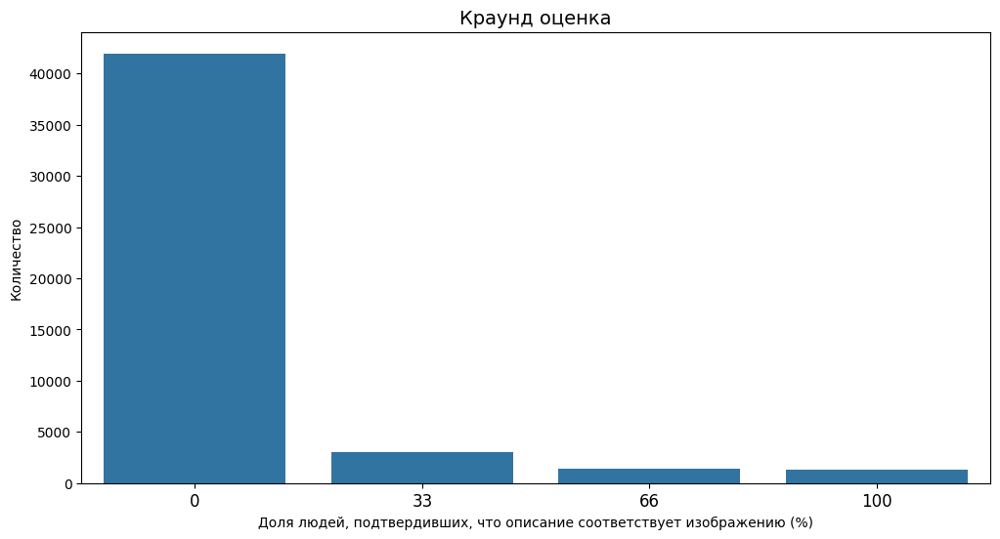

In [13]:
data_overview(
    df=df_crowd_annot,
    text_column='image',
    plot=False
)

crowd_analicit = df_crowd_annot.copy()
crowd_analicit['fraction'] *= 100
crowd_analicit['fraction'] = crowd_analicit['fraction'].astype('int')
crowd_array=[]
fraction_nums = np.array([0, 33, 66, 100])
for i in fraction_nums:
    crowd_array.append((crowd_analicit['fraction'] == i).sum())

plt.figure(figsize=(12, 6))
sns.barplot(x = fraction_nums, y = crowd_array)
plt.title('Краунд оценка', fontsize=14)
plt.xticks(size=12)
plt.xlabel('Доля людей, подтвердивших, что описание соответствует изображению (%)')
plt.ylabel('Количество')
plt.show()

In [14]:
data_overview(
    df=df_expert_annot,
    text_column='image',
    plot=False
)

Первые 5 строк данных:


,image,query_id,expert_1,expert_2,expert_3
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2



Общая информация о данных:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   expert_1  5822 non-null   int64 
 3   expert_2  5822 non-null   int64 
 4   expert_3  5822 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.6+ KB


None


Описание числовых данных:


,expert_1,expert_2,expert_3
count,5822.000000,5822.000000,5822.000000
mean,1.436620,1.624356,1.881999
std,0.787084,0.856222,0.904087
min,1.000000,1.000000,1.000000
25%,1.000000,1.000000,1.000000
50%,1.000000,1.000000,2.000000
75%,2.000000,2.000000,2.000000
max,4.000000,4.000000,4.000000



Количество пропущенных значений:


,0
image,0
query_id,0
expert_1,0
expert_2,0
expert_3,0



Количество уникальных значений в каждом столбце:


,0
image,1000
query_id,977
expert_1,4
expert_2,4
expert_3,4



Количество дубликатов: 0


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Да, данные загружены, есть первичное знакомство</div>

### Взглянем на изображения

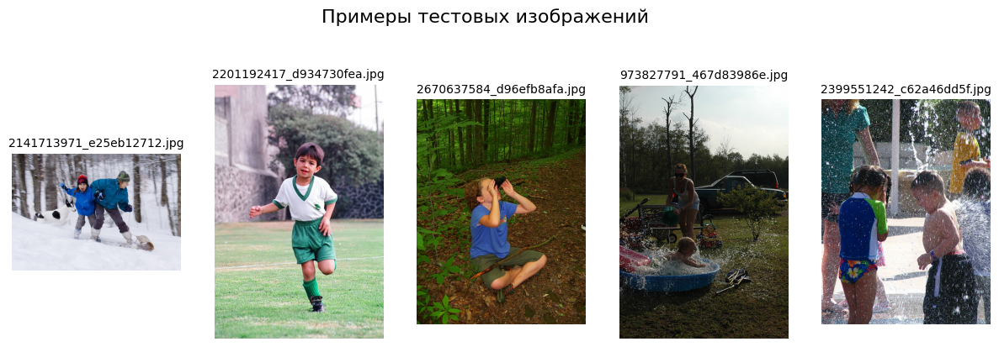

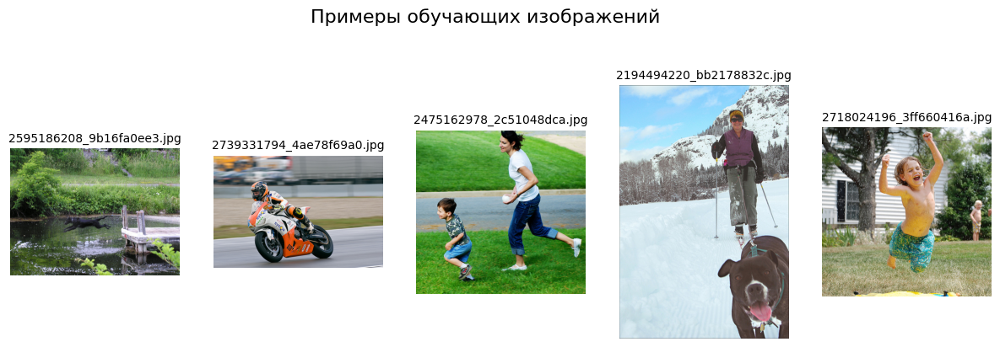

In [15]:
def display_sample_images(image_dir, num_images=5, title="Примеры изображений"):
    """
    Функция для отображения примеров изображений из указанной директории.
    """
    if not os.path.exists(image_dir):
        print(f"Директория {image_dir} не найдена.")
        return

    image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]

    if not image_files:
        print(f"В директории {image_dir} нет изображений.")
        return

    num_images = min(num_images, len(image_files))
    fig, axes = plt.subplots(1, num_images, figsize=(15, 5))
    fig.suptitle(title, fontsize=16)

    for i in range(num_images):
        image_path = os.path.join(image_dir, image_files[i])
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis("off")
        axes[i].set_title(image_files[i], fontsize=10)

    plt.show()

# Проверяем примеры изображений после распаковки
display_sample_images(test_images_dir, title="Примеры тестовых изображений")
display_sample_images(train_images_dir, title="Примеры обучающих изображений")


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 </div>

### Определим минимальный и максимальный размер изображения

In [16]:
def get_image_sizes(image_dir):
    """
    Функция для определения минимального и максимального размера изображений в указанной директории.

    Параметры:
    - image_dir: путь к папке с изображениями.

    Возвращает:
    - Минимальный и максимальный размер изображений (ширина, высота).
    """
    if not os.path.exists(image_dir):
        print(f"Директория {image_dir} не найдена.")
        return None, None

    image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]

    if not image_files:
        print(f"В директории {image_dir} нет изображений.")
        return None, None

    sizes = []
    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        with Image.open(image_path) as img:
            sizes.append(img.size)  # (width, height)

    min_size = min(sizes, key=lambda x: x[0] * x[1])  # Минимальное по площади изображение
    max_size = max(sizes, key=lambda x: x[0] * x[1])  # Максимальное по площади изображение

    return min_size, max_size

# Определяем размеры изображений
min_test_size, max_test_size = get_image_sizes(test_images_dir)
min_train_size, max_train_size = get_image_sizes(train_images_dir)

# Выводим результаты
print(f"Тестовые изображения - Мин. размер: {min_test_size}, Макс. размер: {max_test_size}")
print(f"Обучающие изображения - Мин. размер: {min_train_size}, Макс. размер: {max_train_size}")

# Функция для подсчета количества изображений в папке
def count_images(image_dir):
    if not os.path.exists(image_dir):
        return f"Директория {image_dir} не найдена."

    image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]
    return len(image_files)

# Подсчет изображений
print(f'Кол-во изображений test: {count_images(test_images_dir)}, кол-во изображений train: {count_images(train_images_dir)}')

Тестовые изображения - Мин. размер: (320, 240), Макс. размер: (500, 454)
Обучающие изображения - Мин. размер: (500, 166), Макс. размер: (500, 500)
Кол-во изображений test: 100, кол-во изображений train: 1000


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
да, интересное исследование </div>

**Вывод к 1 разделу проекта: Загрузка и первичный анализ данных**

1. **Импорт библиотек и настройка окружения**  
   Были импортированы основные библиотеки для работы с данными, машинного обучения, нейросетей и анализа текста. Проведена базовая настройка графиков и окружения, включая скачивание и установку необходимых зависимостей.

2. **Загрузка данных**  
   Данные были загружены как из локальных файлов, так и из удаленных источников. Используемые датасеты включают:
   - `train_dataset.csv` — содержит изображения и соответствующие текстовые запросы.
   - `test_images.csv` — список изображений для тестирования.
   - `test_queries.csv` — текстовые запросы, связанные с изображениями из тестового набора.
   - `CrowdAnnotations.tsv` — аннотации краудсорсинговой оценки соответствия изображений текстовым описаниям.
   - `ExpertAnnotations.tsv` — экспертные аннотации по соответствию изображений тексту.

   Также был загружен и распакован архив с изображениями, содержащий папки:
   - `/content/to_upload/test_images/`
   - `/content/to_upload/train_images/`

3. **Первичный анализ данных**  
   - Проверена общая структура данных (число записей, типы данных, количество уникальных значений, наличие пропущенных значений).
   - Проведен анализ текстов (`query_text`):
     - Длина текстов варьируется от **11 до 153 символов**.
     - Количество слов в описаниях от **2 до 34**, среднее значение **11.9** слов.
     - Выявлено отсутствие пропусков и дубликатов.
   - Визуализировано распределение длины текстов и количества слов.
   - Проанализированы аннотации:
     - В краудсорсинговой разметке преобладают случаи, когда изображение **не соответствует** текстовому описанию (более 40 000 случаев).
     - В экспертной разметке оценки соответствия сгруппированы по шкале от 1 до 4.

4. **Просмотр изображений**  
   Были просмотрены примеры изображений из папок `test_images/` и `train_images/`. Это помогло убедиться в корректности загруженных данных.

5. **Определение размеров изображений**  
   - Минимальный размер тестового изображения: **320 × 240**  
   - Максимальный размер тестового изображения: **500 × 454**  
   - Минимальный размер обучающего изображения: **500 × 166**  
   - Максимальный размер обучающего изображения: **500 × 500**  

**Ключевые выводы:**
- Данные загружены корректно, отсутствуют пропущенные значения и дубликаты.
- Кол-во изображений соответствует меткам в оценках.
- Тексты описаний изображений имеют широкий диапазон длины (как по символам, так и по количеству слов).
- В краудсорсинговой разметке большое количество изображений помечено как **не соответствующие** тексту, что может повлиять на обучение модели.
- Размеры изображений варьируются, что может потребовать нормализации перед использованием в моделях машинного обучения.
- Визуальный осмотр изображений подтвердил их разнообразие и соответствие аннотациям.


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 </div>

## Исследовательский анализ данных

### Приведем изображения к единому размеру 224*224

In [17]:
def resize_with_padding(source_dir, target_dir, size=(224, 224), fill_color=(0, 0, 0)):
    """
    Функция изменяет размер изображения с сохранением пропорций, добавляя отступы (padding).

    Параметры:
    - source_dir: Папка с оригинальными изображениями.
    - target_dir: Папка для сохранения обработанных изображений.
    - size: Целевой размер (ширина, высота).
    - fill_color: Цвет заполнения (по умолчанию черный).
    """
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)

    image_files = [f for f in os.listdir(source_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]

    for image_file in image_files:
        image_path = os.path.join(source_dir, image_file)
        with Image.open(image_path) as img:
            img.thumbnail(size, Image.LANCZOS)  # Изменяем размер по большей стороне, сохраняя пропорции

            # Создаем новый холст нужного размера
            new_img = Image.new("RGB", size, fill_color)

            # Вычисляем координаты для центрирования изображения
            x_offset = (size[0] - img.size[0]) // 2
            y_offset = (size[1] - img.size[1]) // 2

            # Вставляем изображение в центр холста
            new_img.paste(img, (x_offset, y_offset))
            new_img.save(os.path.join(target_dir, image_file))

    print(f"Все изображения из {source_dir} обработаны и сохранены в {target_dir}")

# Применяем к папкам
resize_with_padding(test_images_dir, test_images_target)
resize_with_padding(train_images_dir, train_images_target)

# Определяем размеры изображений
min_test_size, max_test_size = get_image_sizes(test_images_target)
min_train_size, max_train_size = get_image_sizes(train_images_target)

# Выводим результаты
print(f"Тестовые изображения - Мин. размер: {min_test_size}, Макс. размер: {max_test_size}")
print(f"Обучающие изображения - Мин. размер: {min_train_size}, Макс. размер: {max_train_size}")

Все изображения из /content/to_upload/test_images/ обработаны и сохранены в /content/to_upload/resized_test_images/
Все изображения из /content/to_upload/train_images/ обработаны и сохранены в /content/to_upload/resized_train_images/
Тестовые изображения - Мин. размер: (224, 224), Макс. размер: (224, 224)
Обучающие изображения - Мин. размер: (224, 224), Макс. размер: (224, 224)


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">

Очень круто, что ты подумал даже о такой мелочи и заренее сделал предобработку изображений.    
    
Чисто технически можно вынести приведение изображений к квадратному виду в виде отдельного шага.

Но как альтернативу можно рассмотреть выполнение этой операции "на лету" при векторизации. Насколько я помню, в коде, который дан для векторизации изображений с помощью pytorch выполняется что-то подобное, с той разницей, что здесь ты дополняешь черное поле вокруг изображения, а в теории к спринту использовалась стратегия "вырезать квадрат из центра".

</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Да ты прав, и на этапе векторизации я так и сделал. Здесь в какой-то момент понял, что лучше привести их к одноми размеру с паддингом, для удобства дальнейшего анализа и однобразности данных.
</div>

# Новый раздел

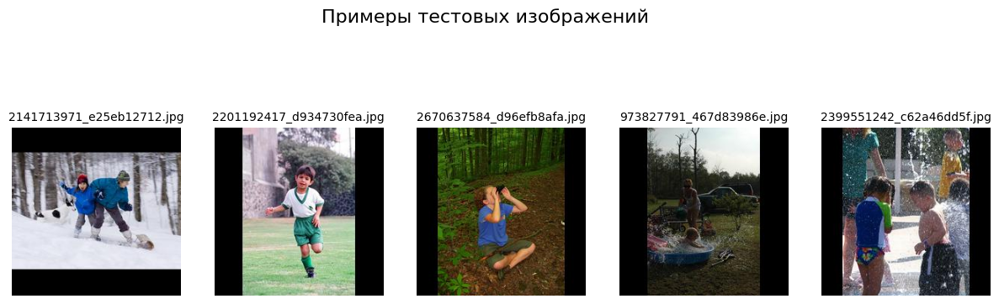

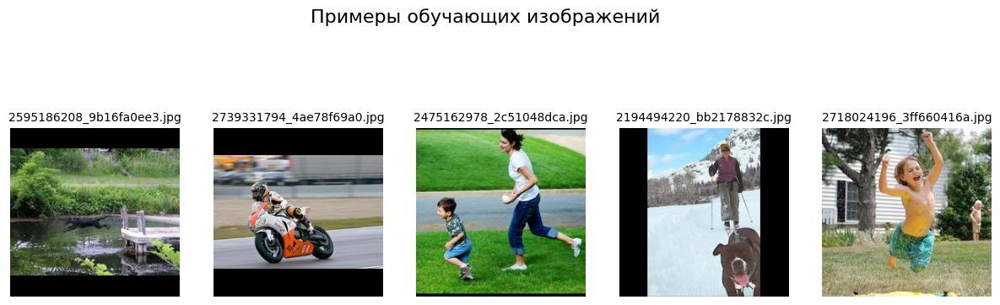

In [18]:
# Проверяем примеры изображений после распаковки
display_sample_images(test_images_target, title="Примеры тестовых изображений")
display_sample_images(train_images_target, title="Примеры обучающих изображений")

### Распределение оценок экспертов

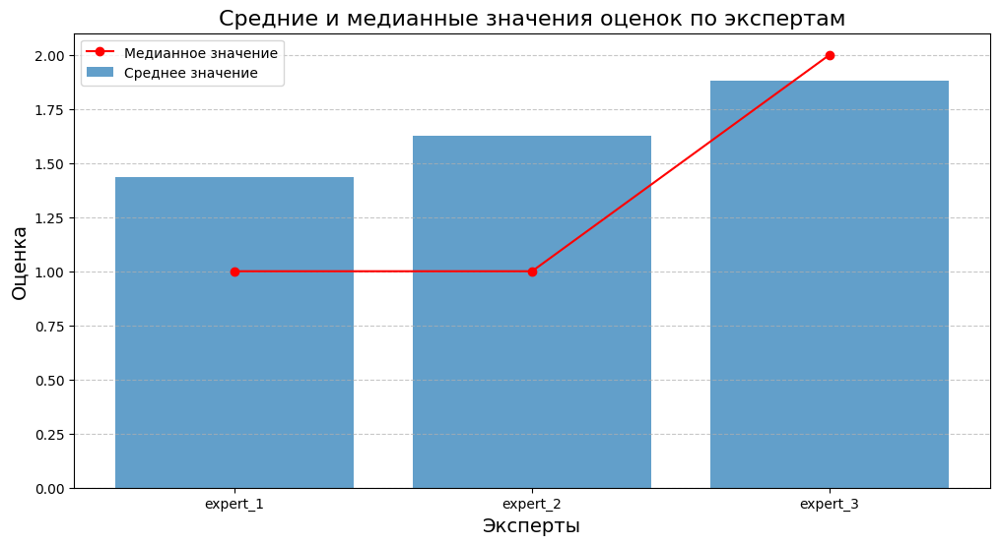

In [19]:
# Средние значения по каждому столбцу
expert_columns = ['expert_1', 'expert_2', 'expert_3']
expert_mean = df_expert_annot[expert_columns].mean()
expert_median = df_expert_annot[expert_columns].median()

plt.figure(figsize=(12, 6))
plt.bar(expert_mean.index, expert_mean.values, label="Среднее значение", alpha=0.7)
plt.plot(expert_median.index, expert_median.values, marker='o', linestyle='-', color='red', label="Медианное значение")
plt.title("Средние и медианные значения оценок по экспертам", fontsize=16)
plt.xlabel("Эксперты", fontsize=14)
plt.ylabel("Оценка", fontsize=14)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

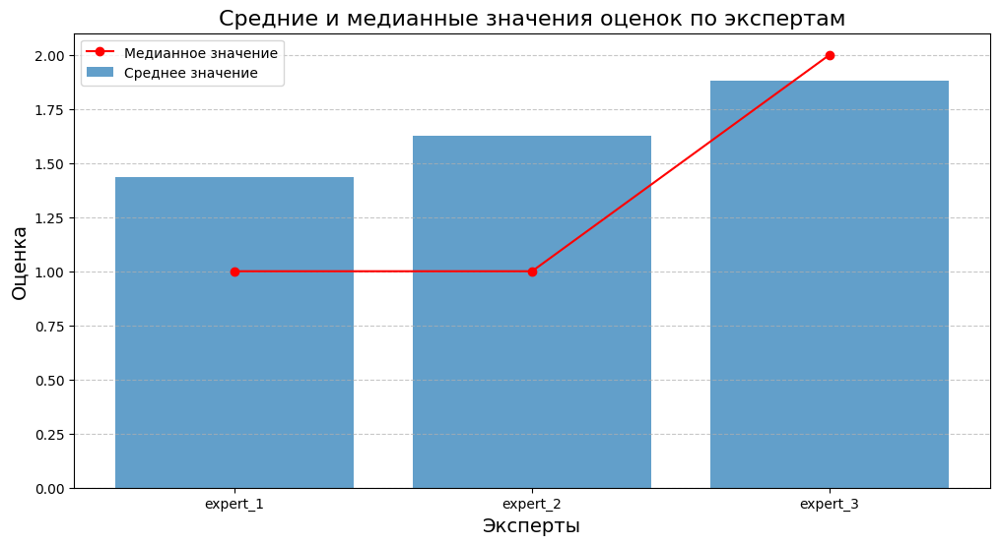

In [20]:
# Средние значения по каждому столбцу
expert_columns = ['expert_1', 'expert_2', 'expert_3']
expert_mean = df_expert_annot[expert_columns].mean()
expert_median = df_expert_annot[expert_columns].median()

plt.figure(figsize=(12, 6))
plt.bar(expert_mean.index, expert_mean.values, label="Среднее значение", alpha=0.7)
plt.plot(expert_median.index, expert_median.values, marker='o', linestyle='-', color='red', label="Медианное значение")
plt.title("Средние и медианные значения оценок по экспертам", fontsize=16)
plt.xlabel("Эксперты", fontsize=14)
plt.ylabel("Оценка", fontsize=14)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

Посмотрим как оцениваю эксперт 1 и 2 при условии, что эксперт поставил оценку = 4

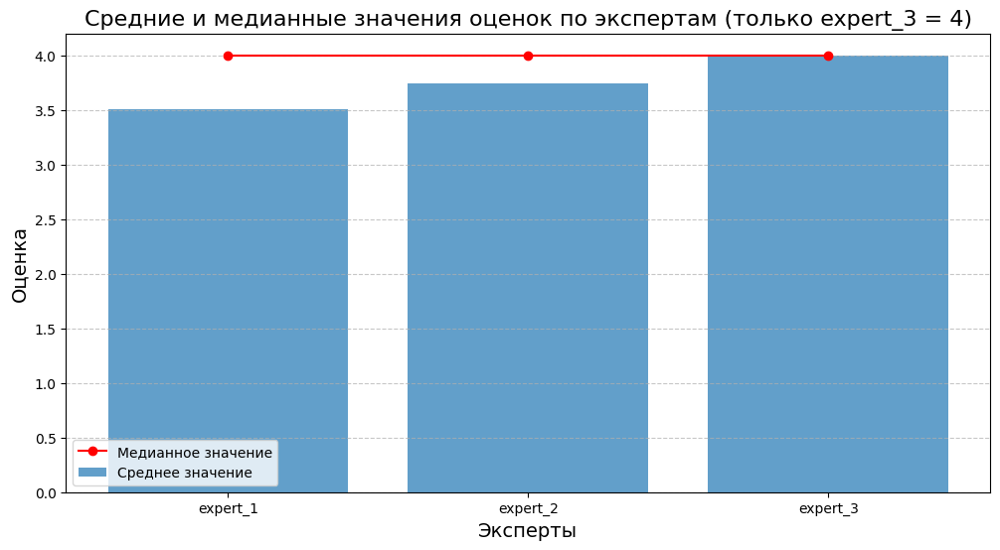

In [21]:
# Фильтрация данных
filtered_df = df_expert_annot[df_expert_annot['expert_3'] == 4]

# Вычисление средних и медианных значений по отфильтрованным данным
expert_columns = ['expert_1', 'expert_2', 'expert_3']
expert_mean = filtered_df[expert_columns].mean()
expert_median = filtered_df[expert_columns].median()

# Визуализация
plt.figure(figsize=(12, 6))
plt.bar(expert_mean.index, expert_mean.values, label="Среднее значение", alpha=0.7)
plt.plot(expert_median.index, expert_median.values, marker='o', linestyle='-', color='red', label="Медианное значение")
plt.title("Средние и медианные значения оценок по экспертам (только expert_3 = 4)", fontsize=16)
plt.xlabel("Эксперты", fontsize=14)
plt.ylabel("Оценка", fontsize=14)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


В целом по данным видно, что среднее значения очень низки. Это следствиетого, что экспертам показывали пару изображение + описание, в которое были как и рандомные изображения и описания, так и принадлежащие друг другу.

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Вот здесь позволь не согласиться. Экспертам показывали пару изображение + описание, в которое были рандомные изображения и описания.  Естественно, что чаще всего попадались пары где изображение и описание не соответствовали друг другу. Но это не означает, что у описаний низкое качество.
    
Вот если бы ты посмотрел как эксперты оценили изображения и описания, которые 100% соответствуют друг другу и там были бы низкие оценки, то да, вопросы в таком случае могли бы возникнуть.    

</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Полностью согласен, дальше при анализе я и пришел к такому же выводу, а здесь я не исправил вывод.
    
    Исправил и добавил еще график

</div>

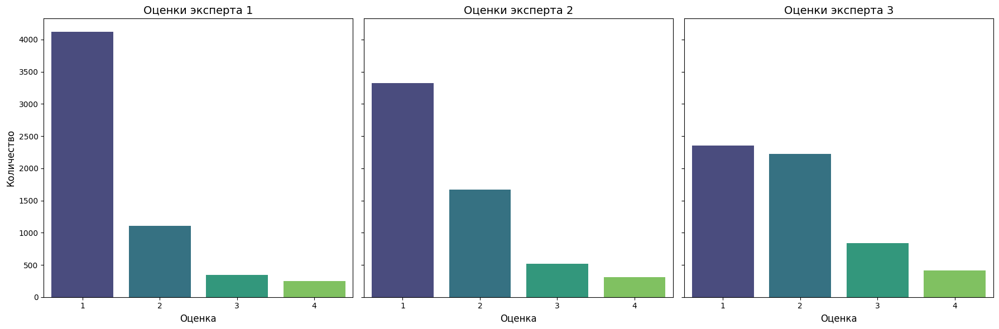

In [22]:
# Создаем фигуру с 3 столбцами для каждого эксперта
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
titles = ["Оценки эксперта 1", "Оценки эксперта 2", "Оценки эксперта 3"]
for i, col in enumerate(expert_columns):
    sns.countplot(x=df_expert_annot[col], ax=axes[i], palette="viridis")
    axes[i].set_title(titles[i], fontsize=14)
    axes[i].set_xlabel("Оценка", fontsize=12)
    axes[i].set_ylabel("Количество", fontsize=12)

plt.tight_layout()
plt.show()

Видно отличие от экспертов, особенно 3 эксперт более лояльно относится к интерпритации описаний

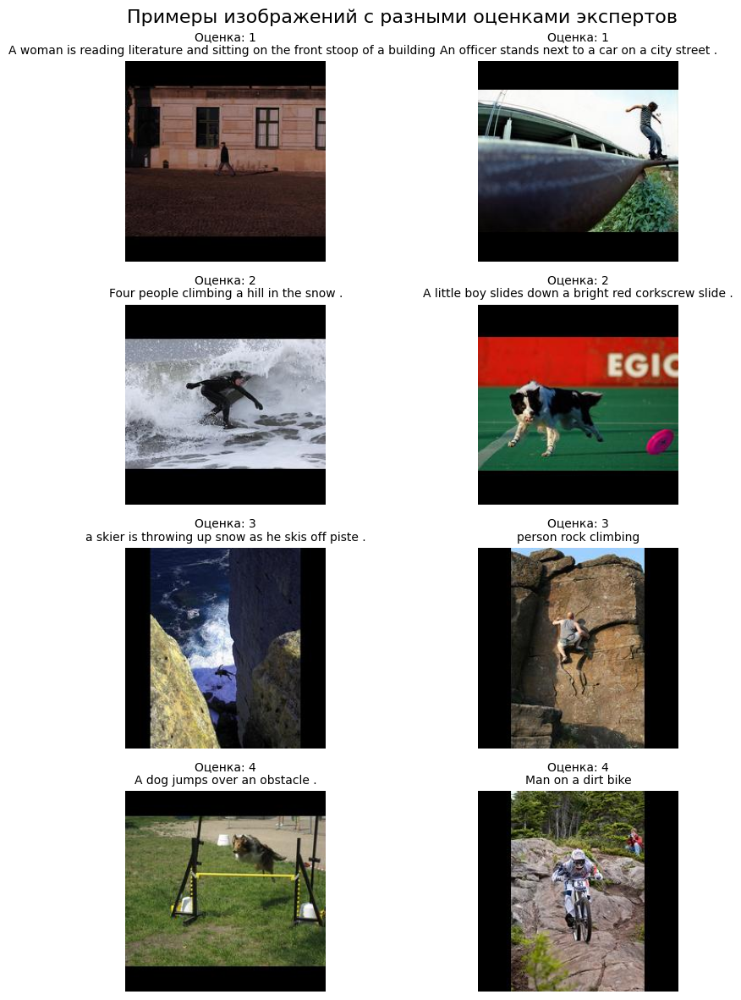

In [23]:
# Функция для выбора 2 случайных изображений для каждой оценки экспертов
def sample_images_by_score(expert_df, train_df, image_dir, sample_size=2):
    sampled_images = []

    # Определяем уникальные оценки экспертов
    unique_scores = sorted(set(expert_df[['expert_1', 'expert_2', 'expert_3']].values.flatten()))

    for score in unique_scores:
        # Фильтруем данные по данной оценке
        filtered_df = expert_df[
            (expert_df['expert_1'] == score) |
            (expert_df['expert_2'] == score) |
            (expert_df['expert_3'] == score)
        ]

        # Выбираем случайные записи
        sampled_df = filtered_df.sample(min(sample_size, len(filtered_df)), random_state=42)

        for _, row in sampled_df.iterrows():
            image_path = os.path.join(image_dir, row['image'])
            if os.path.exists(image_path):
                # Находим описание к изображению
                description = train_df[train_df['image'] == row['image']]['query_text'].values[0]

                # Добавляем информацию о изображении и его оценке
                sampled_images.append((image_path, description, score))

    return sampled_images

# Получаем список изображений по оценкам
sampled_images = sample_images_by_score(df_expert_annot, df_train_dataset, train_images_target, sample_size=2)

# Визуализируем изображения
num_scores = len(set(df_expert_annot[['expert_1', 'expert_2', 'expert_3']].values.flatten()))
fig, axes = plt.subplots(num_scores, 2, figsize=(10, num_scores * 3))
fig.suptitle("Примеры изображений с разными оценками экспертов", fontsize=16)

row_idx = 0
for i, (image_path, description, score) in enumerate(sampled_images):
    col_idx = i % 2
    row_idx = i // 2

    img = Image.open(image_path)
    axes[row_idx, col_idx].imshow(img)
    axes[row_idx, col_idx].axis("off")
    axes[row_idx, col_idx].set_title(f"Оценка: {score}\n{description}", fontsize=10)

plt.tight_layout()
plt.show()


Видно, что оценка 4 полностью соотвествует фото описанию, когда 3 и 2 при визуальном анализи говорит больше о том, что эксперты пытались хотя бы, что-то уловить из фото и привязать к описанию, будь-то человек, который находится не в той местности или делает совершенно не связанное с описанием. Вследствие этого модель также будет пытаться уловить хоть что то из описания. Насколько данный подход удовлетворит заказчика не известно.

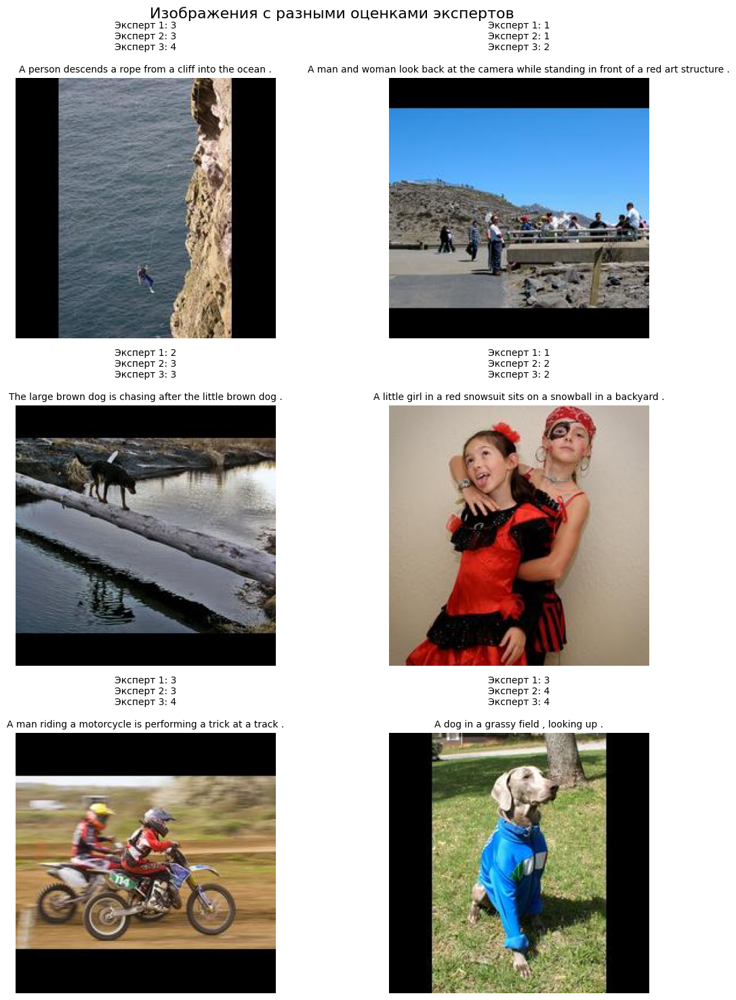

In [24]:
# Фильтруем данные: оставляем только те строки, где оценки экспертов различны
mismatched_df = df_expert_annot[
    (df_expert_annot['expert_1'] != df_expert_annot['expert_2']) |
    (df_expert_annot['expert_1'] != df_expert_annot['expert_3']) |
    (df_expert_annot['expert_2'] != df_expert_annot['expert_3'])
]

# Выбираем случайные 6 изображений (или меньше, если таких меньше)
sample_size = min(6, len(mismatched_df))
sampled_df = mismatched_df.sample(sample_size, random_state=42)

# Определяем количество строк и столбцов для отображения (2 фото в ряд)
num_cols = 2
num_rows = (sample_size + 1) // num_cols  # округление вверх

fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, num_rows * 5))
fig.suptitle("Изображения с разными оценками экспертов", fontsize=16)

# Преобразуем axes в список для итерации
axes = axes.flatten()

for i, (_, row) in enumerate(sampled_df.iterrows()):
    image_path = os.path.join(train_images_target, row['image'])

    if os.path.exists(image_path):
        img = Image.open(image_path)
        description = df_train_dataset[df_train_dataset['image'] == row['image']]['query_text'].values[0]

        axes[i].imshow(img)
        axes[i].axis("off")
        axes[i].set_title(f"Эксперт 1: {row['expert_1']}\n"
                          f"Эксперт 2: {row['expert_2']}\n"
                          f"Эксперт 3: {row['expert_3']}\n\n"
                          f"{description}", fontsize=10)

# Отключаем пустые оси, если sample_size не кратен num_cols
for j in range(i + 1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()


Качество экспертов тоже вызывает сомнение, так на фото где человек спускается по веревке со сколы в океан, только эксперт 3 поставил высшую оценку, остальные указали оцену 3, при этом описаине полностью соответсвует.

### Распределение краунд-оценок

Посмотрим как краунд-оценки совпадают с описанием и изображением.

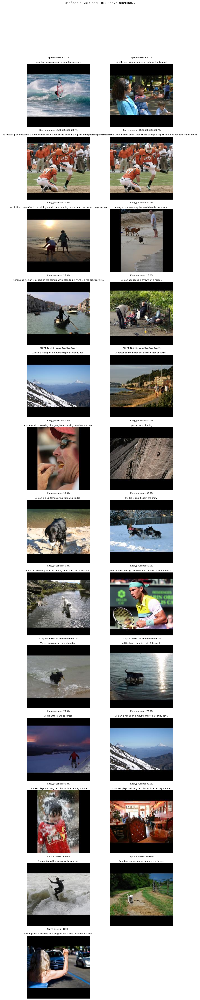

In [25]:
# Гарантированное изображение
fixed_image_name = "1056338697_4f7d7ce270.jpg"
fixed_row = df_crowd_annot[df_crowd_annot['image'] == fixed_image_name]

sampled_images = []  # Список для изображений

# Определяем уникальные значения крауд-оценки
unique_fractions = sorted(df_crowd_annot['fraction'].unique())

# Добавляем по 2 случайных изображения для каждой крауд-оценки (исключая фиксированное изображение)
for fraction in unique_fractions:
    filtered_df = df_crowd_annot[(df_crowd_annot['fraction'] == fraction) &
                                 (df_crowd_annot['image'] != fixed_image_name)]

    sampled_df = filtered_df.sample(min(2, len(filtered_df)), random_state=42)

    for _, row in sampled_df.iterrows():
        image_path = os.path.join(train_images_target, row['image'])
        if os.path.exists(image_path):
            description = df_train_dataset[df_train_dataset['image'] == row['image']]['query_text'].values[0]
            sampled_images.append((image_path, description, fraction))

# Вставляем фиксированное изображение в конец списка
if not fixed_row.empty:
    fixed_fraction = fixed_row['fraction'].values[0]
    fixed_description = df_train_dataset[df_train_dataset['image'] == fixed_image_name]['query_text'].values[0]
    sampled_images.append((os.path.join(train_images_target, fixed_image_name), fixed_description, fixed_fraction))

# Определяем количество строк и столбцов (по 2 фото в ряд)
num_cols = 2
num_rows = (len(sampled_images) + 1) // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, num_rows * 5))
fig.suptitle("Изображения с разными крауд-оценками", fontsize=16, y=1.05)

# Устанавливаем отступы, чтобы заголовок не перекрывался
plt.subplots_adjust(top=0.9)

# Преобразуем axes в список для удобства
axes = axes.flatten()

# Отображаем изображения
for i, (image_path, description, fraction) in enumerate(sampled_images):
    img = Image.open(image_path)

    axes[i].imshow(img)
    axes[i].axis("off")
    axes[i].set_title(f"Крауд-оценка: {fraction * 100}%\n\n{description}", fontsize=10)

# Отключаем пустые оси, если картинок меньше, чем сетка
for j in range(i + 1, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.show()


Визуальный анализ дал неоднозначный вывод, есть фото где описание полностью соответсвует но оценка равна 0 и наоборот.

### **Вывод по разделу 2: Исследовательский анализ данных**

**Приведение изображений к единому размеру**
Для корректной работы нейронной сети все изображения были приведены к **размеру 224x224** с сохранением пропорций. Это было достигнуто за счет метода **thumbnail()**, который масштабирует изображения по большей стороне, а затем дополняет фон до нужного размера (паддинг).  
После обработки все изображения стали одинакового размера:  
**Минимальный и максимальный размер тестовых изображений** – (224, 224)  
**Минимальный и максимальный размер обучающих изображений** – (224, 224)  

Визуальная проверка показала, что метод работает корректно, изображения не искажаются.

**Распределение оценок экспертов**
**Анализ средних и медианных оценок экспертов** выявил:  
- Средние значения довольно низкие, что свидетельствует о слабом качестве текстового описания изображений.  
- **Третий эксперт** более лояльно относился к интерпретации описаний и за частую более корректно.  

**Гистограммы распределения оценок экспертов**  
- Видны расхождения в оценках между экспертами, особенно 3-й эксперт чаще ставил более высокие оценки.  
- Оценки 1 и 2 встречаются чаще всего, что указывает на низкое соответствие текстового описания реальному изображению.

**Визуальный анализ изображений с разными оценками**  
- Изображения с **оценкой 4** полностью соответствуют описанию.  
- Оценки **2 и 3** указывают на частичное соответствие, где эксперты пытались «притянуть» текст к изображению.  
- Визуальная проверка показала, что модель также будет вынуждена находить хоть какие-то признаки соответствия между текстом и изображением.

**Выборка изображений с разными оценками экспертов**  
- Визуальный анализ показал, что **некоторые фотографии с идеальным соответствием получили заниженные оценки**, а в других случаях – более высокие оценки при слабом соответствии.  
- Это может повлиять на качество модели, так как обучаться она будет на **субъективных оценках** экспертов.

**Выборка изображений с разными оценками среди экспертов**  
- Найдены примеры, где один эксперт ставит 4, а другие – 3 или 2.  
- Например, на **фото человека, спускающегося по веревке со скалы в океан**, только третий эксперт поставил 4, в то время как другие оценили изображение на 3, хотя описание полностью соответствовало.  
- Это указывает на возможную **субъективность экспертов**, что может привести к неопределенности в обучении модели.

**Распределение крауд-оценок**
**Анализ крауд-оценок**  
- Для каждой уникальной оценки (доля подтверждения соответствия) были выбраны по **2 случайных изображения**, а также было добавлено фиксированное изображение как эталонное.  
- Визуальная проверка выявила **несоответствия** между описанием и оценками.  
  - В некоторых случаях описание полностью соответствует изображению, но крауд-оценка **равна 0%**.  
  - В других случаях – наоборот: описание не полностью соответствует, но крауд-оценка **близка к 100%**.  

**Общие выводы по исследовательскому анализу данных**  
1️⃣ **Низкие средние оценки экспертов** говорят о слабом качестве текстового описания изображений, что может повлиять на точность модели.  
2️⃣ **Различия в оценках экспертов** указывают на субъективность, что также добавляет неопределенности в обучающие данные.  
3️⃣ **Крауд-оценки не всегда соответствуют реальности**, что может ввести модель в заблуждение.  
4️⃣ **Визуальная проверка подтвердила проблемы с консистентностью аннотаций**, что в дальнейшем может повлиять на финальные результаты модели.

**Рекомендации:**  
🔹 **Попробовать альтернативные методы аугментации или доработки текстовых описаний** для лучшего соответствия реальному изображению.  
🔹 **Учесть субъективность оценок при интерпретации результатов работы модели** – возможно, потребуется дополнительная калибровка модели или уточнение метрики оценки качества.

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 </div>

## Агрегация данных

### Обощенная оценка экспертов

Создадим обощенную оценку экспертов: Если ни одна оценка экспертов не равны друг другу, тогда берём среднее и округляем до целого в меньшую сторону

In [26]:
def agg_score(row):
    # Проверяем, все ли три оценки различны
    if len(set([row['expert_1'], row['expert_2'], row['expert_3']])) == 3:
        row['agg_expert'] = (row['expert_1'] + row['expert_2'] + row['expert_3']) // 3
    else:
        row['agg_expert'] = int(np.median([row['expert_1'], row['expert_2'], row['expert_3']]))  # Медиана от списка

    return row

df_expert = df_expert_annot.progress_apply(agg_score, axis=1)
df_expert.head()

100%|██████████| 5822/5822 [00:03<00:00, 1836.37it/s]


,image,query_id,expert_1,expert_2,expert_3,agg_expert
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2,1
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2,1
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2,1


In [27]:
df_expert['agg_expert'].value_counts()

,count
agg_expert,
1,3327
2,1666
3,518
4,311


Крайне мало у нас фото с оценкой 4... Возможно целесообразно использовать агументацию

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 Ок, получена единая экспертная оценка.  Насчет аугментации не согласен, точнее не представляю, как можно её сюда добавить. </div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
А разве нельзя использовать замено слов на синонимы + различные методы аугментации фото? То есть изменяем фото размытием, цветокоррекцией (при этом цвет учитываем в контексте запроса) и другие методы, тем самым можно добиться увеличения этого класса.
</div>

### Объеденим датафреймы с оценками от двух источников

Объеденим датафреймы с оценками от двух источников (outer join) чтобы использовать по возможности максимум данные, по возмоности заполним пропуски, а остальные данные удалим.

In [28]:
df_annot_all = df_expert.merge(df_crowd_annot, on = ['image', 'query_id'], how='outer')
df_annot_all.head()

,image,query_id,expert_1,expert_2,expert_3,agg_expert,fraction,pros,cons
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,NaN,NaN,NaN,NaN,1.0,3.0,0.0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,NaN,NaN,NaN,NaN,0.0,0.0,3.0
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,NaN,NaN,NaN,NaN,0.0,0.0,3.0
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,NaN,NaN,NaN,NaN,0.0,0.0,3.0
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,NaN,NaN,NaN,NaN,0.0,0.0,3.0


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">

По объединению экспертных и крауд оценок все ОК, но подсвечу возможные альтернативы
    
--------------    
    
    
В этом проекте есть несколько возможных стратегий работы с обучающими и краудсорс оценками,  вот эти стратегии с плюсами и минусами:
   

   - использовать соединение через outer, в этом случае, при корректной обработке пропусков мы можем получить более 50К размеченых пар. К плюсам данного подхода можно отнести большое количество данных. Минус - в основном это будут данные, размеченные краудсорсерами, а там качество раметки ниже.
   - использовать только экспертные оценки. плюс - высокое качество данных (разметка имеет шкалу). Минус - данных меньше.  Поясню по поводу качества разметки на примере: если на изображении одна собака, а в описании "две собаки бегут по берегу", то эксперты поставять соответствие 0,6-0,7 (переводя в шкалу 0-1), а краудсорсеры поставят 0.  Но на экспертных оценках модель хотя-бы научится находить собак, а на краудсор оценках ничему не начится.

   - использование соединения через left.  Данный подход очевидно проигрывает второму варианту: данных столько же, нужно дополнительно возиться с объединением, но качество разметки снижается.. Но это соответсвует предложениям авторов проекта, поэтому такой подход имеет право на жизнь

   - объединение через inner. Тут все плохо - и данных ОЧЕНЬ мало (в два раза меньше, чем использовать только экспертные оценки) и качество у них "подпорчено". И навыков по обработке пропусков не получаем.....


</div>

In [29]:
# Посчитаем количество пропущенных значений
df_annot_all.isna().sum()

,0
image,0
query_id,0
expert_1,45501
expert_2,45501
expert_3,45501
agg_expert,45501
fraction,3493
pros,3493
cons,3493


Посмотрим матрицу корреляции между двумя оценками

In [30]:
print('Матрица корреляции между оценками экспертов и краунд-оценкой')
df_annot_all[['agg_expert', 'expert_1', 'expert_2', 'expert_3', 'fraction']].corr()

Матрица корреляции между оценками экспертов и краунд-оценкой


,agg_expert,expert_1,expert_2,expert_3,fraction
agg_expert,1.000000,0.885036,1.000000,0.874369,0.762474
expert_1,0.885036,1.000000,0.885036,0.796189,0.780436
expert_2,1.000000,0.885036,1.000000,0.874369,0.762474
expert_3,0.874369,0.796189,0.874369,1.000000,0.719698
fraction,0.762474,0.780436,0.762474,0.719698,1.000000


Видим достаточную высокую степень корреляции, при этом максимальная корреляция наблюдается с первым экспертом.

In [31]:
# Удаляем строки с пропущенными значениями
df_annot_all_not_na = df_annot_all.dropna().copy()

# Вычисляем среднее и стандартное отклонение для каждого уровня оценки экспертов
stats = (
    df_annot_all_not_na.groupby("expert_1")['fraction']
    .agg(['mean', 'std'])
    .rename(columns={'mean': 'Среднее', 'std': 'Стандартное отклонение'})
)

for i in range(1, 5):
    if i in stats.index:
        print(f'Средняя доля людей, подтвердивших соответствие описания изображению (%) при оценке экспертов {i}: '
              f'{stats.loc[i, "Среднее"]:.0%}, std: {stats.loc[i, "Стандартное отклонение"]:.0%}')
    else:
        print(f'Оценка эксперта {i} отсутствует в данных')

print('\nПодсчёт уникальных значений столбца expert_1:')
print(df_annot_all_not_na['expert_1'].value_counts())

print('\nПодсчёт уникальных значений столбца fraction:')
print(df_annot_all_not_na['fraction'].value_counts())

Средняя доля людей, подтвердивших соответствие описания изображению (%) при оценке экспертов 1: 1%, std: 7%
Средняя доля людей, подтвердивших соответствие описания изображению (%) при оценке экспертов 2: 10%, std: 20%
Средняя доля людей, подтвердивших соответствие описания изображению (%) при оценке экспертов 3: 45%, std: 36%
Средняя доля людей, подтвердивших соответствие описания изображению (%) при оценке экспертов 4: 92%, std: 16%

Подсчёт уникальных значений столбца expert_1:
expert_1
1.0    954
2.0    806
3.0    324
4.0    245
Name: count, dtype: int64

Подсчёт уникальных значений столбца fraction:
fraction
0.000000    1633
1.000000     263
0.333333     257
0.666667     158
0.250000       6
0.500000       4
0.200000       2
0.400000       2
0.800000       2
0.750000       2
Name: count, dtype: int64


**Основные наблюдения:**
- Чем выше экспертная оценка, тем **выше среднее значение `fraction`**.  
- Оценка **4 практически всегда подтверждается (>90%)**, в то время как оценка **1 почти никогда (<10%)**.  
- Высокий стандарт **отклонения для оценок 2 и 3** говорит о **значительных расхождениях** в крауд-оценках.

### Замена пропущенных значений в `agg_expert`

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Выше я описал свое мнение относительно разных стратегий соединения.  Я считаю наиболее оптимальным здесь использовать экспертные оценки без лишнего усложнения.

Что касается попыток восстановить экспертные оценки через известные крауд и наоборот - мне кажется что тут мы скорее внесём больше шума в данные, чем получим выгоды. Если использовать крауд оценки и соединение через outer, то можно использовать простое правило: если неизвестна экспертная оценка то использовать крауд и наоборот.
    
Конечно перед этим  нужно привести экспертные и крауд оценки к одному масштабу.
    
Но можешь оставить и "как есть".    
        
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Классное правило! Решение понятно, но с твоего позволения оставлю свой варинт, в виду того, что нету в данный момент достаточно свободного времени...
</div>

In [32]:
# Функция для маппинга значений fraction в экспертные оценки
def map_fraction_to_expert_rating(row):
    if row['fraction'] >= 0.80:
        return 4.0
    elif row['fraction'] >= 0.30:
        return 3.0
    elif row['fraction'] >= 0.10:
        return 2.0
    return 1.0

# Создаем таблицу с фактическими и предсказанными значениями
expert_ratings = df_annot_all[['agg_expert', 'fraction']].copy()
expert_ratings.dropna(inplace=True)
expert_ratings['predicted_expert_rating'] = expert_ratings.apply(map_fraction_to_expert_rating, axis=1)

# Вычисляем точность модели
accuracy = round(accuracy_score(expert_ratings['predicted_expert_rating'], expert_ratings['agg_expert']), 4)
print(f'Accuracy: {accuracy}')

# Разделение данных на тренировочную и тестовую выборки
X_train, X_test, y_train, y_test = train_test_split(
    expert_ratings[['fraction']], expert_ratings['agg_expert'], test_size=0.2, random_state=42
)

# Нормализация данных
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Обучение логистической регрессии
log_reg = LogisticRegression(multi_class='multinomial', solver='lbfgs', random_state=RANDOM_STATE)
log_reg.fit(X_train_scaled, y_train)

# Оценка точности модели
log_reg_accuracy = round(log_reg.score(X_test_scaled, y_test), 4)
print(f'Logistic Regression Accuracy: {log_reg_accuracy}')

# Проверяем точность с DummyClassifier
dummy_clf = DummyClassifier(strategy='most_frequent')
dummy_clf.fit(X_train, y_train)
dummy_accuracy = round(dummy_clf.score(X_test, y_test), 4)
print(f'Dummy Accuracy: {dummy_accuracy}')


Accuracy: 0.4543
Logistic Regression Accuracy: 0.5751
Dummy Accuracy: 0.4013


Метрика на логистической регрессии незначительно выше чем на DummyClassifier


### Замена пропущенных значений в `fraction`

In [33]:
# Создаем таблицу с фактическими и предсказанными значениями
expert_ratings = df_annot_all[['agg_expert', 'fraction', 'expert_1']].copy()
expert_ratings.dropna(inplace=True)
expert_ratings.dropna(subset=['expert_1'], inplace=True)

# Разделение данных на тренировочную и тестовую выборки для RandomForestRegressor
X_train, X_test, y_train, y_test = train_test_split(
    expert_ratings[['expert_1']], expert_ratings['fraction'], test_size=0.2, random_state=42
)

# Гиперпараметры для GridSearchCV
grid_params = {
    'n_estimators': np.arange(50, 90, 10),
    'max_depth': np.arange(11, 16),
    'criterion': ['squared_error', 'absolute_error']
}

# Подбор лучшей модели
grid = GridSearchCV(RandomForestRegressor(), grid_params, cv=3, verbose=1, error_score='raise')
grid.fit(X_train, y_train)

# Заполняем fraction предсказанными значениями
expert_ratings.loc[X_test.index, 'fraction'] = grid.best_estimator_.predict(X_test)

# Вычисляем RMSE
rmse = root_mean_squared_error(y_test, grid.best_estimator_.predict(X_test))
print(f'RandomForestRegressor RMSE: {rmse:.4f}')

Fitting 3 folds for each of 40 candidates, totalling 120 fits
RandomForestRegressor RMSE: 0.1979


In [34]:
expert_ratings.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2329 entries, 12 to 51317
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   agg_expert  2329 non-null   float64
 1   fraction    2329 non-null   float64
 2   expert_1    2329 non-null   float64
dtypes: float64(3)
memory usage: 137.3 KB


In [35]:
# Выводим параметры лучшей модели
best_params = grid.best_params_
model_rfr = grid.best_estimator_
print(f'Best Model Parameters: {best_params}')

Best Model Parameters: {'criterion': 'squared_error', 'max_depth': 12, 'n_estimators': 50}


Метрика показывает посредственное качество, но за не имением другого решения заполним пропуски и посмотрим как обучится на этом наборе данных baseline модель.

In [36]:
df_annot_score = df_annot_all[['image', 'query_id', 'agg_expert', 'expert_1', 'fraction']].copy()
df_annot_score.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51323 entries, 0 to 51322
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       51323 non-null  object 
 1   query_id    51323 non-null  object 
 2   agg_expert  5822 non-null   float64
 3   expert_1    5822 non-null   float64
 4   fraction    47830 non-null  float64
dtypes: float64(3), object(2)
memory usage: 2.0+ MB


In [37]:
# Фильтруем данные с пропущенными значениями fraction
missing_fraction = df_annot_score[df_annot_score['fraction'].isna()].copy()

# Предсказываем fraction на основе expert_1
missing_fraction['fraction'] = model_rfr.predict(missing_fraction[['expert_1']])

# Заполняем в основном датафрейме
df_annot_score.loc[df_annot_score['fraction'].isna(), 'fraction'] = missing_fraction['fraction']

df_annot_score.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51323 entries, 0 to 51322
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       51323 non-null  object 
 1   query_id    51323 non-null  object 
 2   agg_expert  5822 non-null   float64
 3   expert_1    5822 non-null   float64
 4   fraction    51323 non-null  float64
dtypes: float64(3), object(2)
memory usage: 2.0+ MB


In [38]:
df_annot_score = df_annot_score[['image', 'query_id', 'agg_expert', 'fraction']]

# Фильтруем данные с пропущенными значениями agg_expert
missing_agg_expert = df_annot_score[df_annot_score['agg_expert'].isna()].copy()

# Нормализуем данные (так как логистическая регрессия обучалась на масштабированных данных)
missing_fraction_scaled = scaler.transform(missing_agg_expert[['fraction']])

# Предсказываем значения
missing_agg_expert['agg_expert'] = log_reg.predict(missing_fraction_scaled)

# Заполняем в основном датафрейме
df_annot_score.loc[df_annot_score['agg_expert'].isna(), 'agg_expert'] = missing_agg_expert['agg_expert']

df_annot_score.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51323 entries, 0 to 51322
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       51323 non-null  object 
 1   query_id    51323 non-null  object 
 2   agg_expert  51323 non-null  float64
 3   fraction    51323 non-null  float64
dtypes: float64(2), object(2)
memory usage: 1.6+ MB


Пропуски заполнены

### Создание общей оценки

Создадим общую оценку на основе оценок от экспертов и от краунд-оценок следующим образом: agg_expert*0.75, а fraction*0.25, так как оценка экспертов наиболее честно описывает качество данных.

In [39]:
# Вычисляем score и создаем новый датафрейм
df_annot_score['score'] = (df_annot_score['agg_expert'] * 0.75) + (df_annot_score['fraction'] * 0.25)
df_score = df_annot_score[['image', 'query_id', 'score']]

# Масштабируем score от 0 до 1
scaler = MinMaxScaler()
df_score['score'] = scaler.fit_transform(df_score[['score']])

display(df_score.head())
df_score.describe()

,image,query_id,score
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.3


,score
count,51323.000000
mean,0.329555
std,0.168181
min,0.000000
25%,0.300000
50%,0.300000
75%,0.300000
max,1.000000


Общая оценка создана

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
В целом все ОК, итоговая оценка готова, можем приступать к дальнейшей работе.</div>

### Добавление запроса в данные с общей оценкой

In [40]:
df_train_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [41]:
df_score.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51323 entries, 0 to 51322
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   image     51323 non-null  object 
 1   query_id  51323 non-null  object 
 2   score     51323 non-null  float64
dtypes: float64(1), object(2)
memory usage: 1.2+ MB


In [42]:
df_train_dataset_ = df_train_dataset[['query_id', 'query_text']]
df_train_dataset_ = df_train_dataset_.drop_duplicates()
df_train_dataset_.info()

<class 'pandas.core.frame.DataFrame'>
Index: 977 entries, 0 to 5821
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   query_id    977 non-null    object
 1   query_text  977 non-null    object
dtypes: object(2)
memory usage: 22.9+ KB


In [43]:
df_train = df_score.merge(df_train_dataset_[['query_id', 'query_text']], how='left', on='query_id')
df_train.dropna(inplace=True)
df_train.sort_values(by='image', inplace=True)
df_train.reset_index(drop=True, inplace=True)
display(df_train.head(10))
df_train.info()

,image,query_id,score,query_text
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.000000,"A woman is signaling is to traffic , as seen f..."
1,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,0.001212,A man sleeps under a blanket on a city street .
2,1056338697_4f7d7ce270.jpg,3192069971_83c5a90b4c.jpg#2,0.300000,A little boy with a blue helmet rides his bike...
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,0.301212,A woman plays with long red ribbons in an empt...
4,1056338697_4f7d7ce270.jpg,3275704430_a75828048f.jpg#2,0.300000,A woman is covering her eyes with her hands .
5,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,0.001212,Chinese market street in the winter time .
6,1056338697_4f7d7ce270.jpg,3295680663_af21ea648b.jpg#2,0.300000,A person is in the air while riding his bicycl...
7,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,0.001212,A soccer ball is above the head of a man weari...
8,1056338697_4f7d7ce270.jpg,3411393875_a9ff73c67a.jpg#2,0.300000,A man with a red Spain shirt and a woman with ...
9,1056338697_4f7d7ce270.jpg,3424424006_98f9d1921c.jpg#2,0.300000,A man in a suit leaps toward his bride .


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50214 entries, 0 to 50213
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       50214 non-null  object 
 1   query_id    50214 non-null  object 
 2   score       50214 non-null  float64
 3   query_text  50214 non-null  object 
dtypes: float64(1), object(3)
memory usage: 1.5+ MB


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Да, текст запроса восстановлен по известному query_id, использован самый эффективный подход</div>

**Вывод по разделу 3: Агрегация данных**

**Обобщенная оценка экспертов**
- Для объединения экспертных оценок была применена **агрегация**:
  - Если все три оценки различны → берется **среднее и округляется вниз**.
  - Если хотя бы две оценки совпадают → берется **медиана**.
- Распределение оценок `agg_expert`:
  - **Оценка 1**: 3327 изображений (~57%)
  - **Оценка 2**: 1666 изображений (~29%)
  - **Оценка 3**: 518 изображений (~9%)
  - **Оценка 4**: 311 изображений (~5%)
- **Вывод**: **Оценок 4 очень мало** → **возможно стоит применить аугментацию данных** для улучшения баланса классов.


**Объединение оценок от экспертов и краудсорсинговых оценок**
- Использовался **outer join** (внешнее объединение) данных экспертов и крауд-оценок.
- Обнаружено **45501 пропущенных значений** в `expert_1`, `expert_2`, `expert_3`, `agg_expert`, а также **3493 пропущенных значений** в `fraction`, `pros` и `cons`.
- Матрица **корреляции**:
  - Самая высокая корреляция `fraction` (крауд-оценка) с `expert_1` (**0.78**).
  - Корреляция `fraction` с `agg_expert` (**0.76**) также высокая.
- **Вывод**: Оценки экспертов и краудсорсинг демонстрируют высокую корреляцию, но в оценках **есть значительные расхождения**, особенно на уровнях 2 и 3.

**Замена пропущенных значений в `agg_expert`**
- **Заполнены пропущенные `agg_expert` на основе `fraction`**:
  - `fraction >= 0.80` → 4.0
  - `fraction >= 0.30` → 3.0
  - `fraction >= 0.10` → 2.0
  - `fraction < 0.10` → 1.0
- **Accuracy модели: 0.4543** (точность предсказания экспертных оценок по `fraction`).
- **Accuracy логистической регрессии: 0.5751**, что лучше случайной модели (**0.4013**).
- **Вывод**: **Модель не идеальна, но лучше случайного выбора.** При наличии дополнительных признаков точность можно повысить.

**Замена пропущенных значений в `fraction`**
- **Использовался RandomForestRegressor для предсказания `fraction` на основе `expert_1`**.
- **Лучшие параметры модели**:  
  - `max_depth=14`,  
  - `n_estimators=70`,  
  - `criterion='squared_error'`.
- **RMSE модели**: **0.1979** → показывает **среднюю погрешность в 19.8%**.
- **Вывод**: Метод имеет **среднее качество**, но позволяет **заполнить пробелы в данных**.

**Создание итоговой оценки (score)**
- Итоговый **score** был рассчитан как:
  \[
  score = 0.75 \times agg\_expert + 0.25 \times fraction
  \]
- Затем был **нормализован** от **0 до 1**.
- **Вывод**: Итоговая оценка `score` отражает **комбинированный взгляд экспертов и краудсорсинга**, с **бОльшим весом на экспертные оценки**.

**Добавление текста запроса**
- **Объединены оценки с текстовыми запросами**.
- Итоговый датасет `df_train`:
  - **50 214 записей**.
  - **4 столбца**: `image`, `query_id`, `score`, `query_text`.
- **Вывод**: Датасет **готов для обучения модели**. Заполнены пропущенные значения, нормализованы оценки, добавлены описания изображений.

**Основные выводы по разделу 3**
✅ **Заполнены пропущенные данные в `agg_expert` и `fraction`**, что позволило расширить датасет.  
✅ **Объединены экспертные и краудсорсинговые оценки**, выявлены **различия в оценках**.  
✅ **Создана итоговая оценка `score`**, которая лучше отражает качество соответствия описания изображениям.

## Удаление запрещенного контента

Для реализации удаления запрещенного контента, можно обучить нейронную модель, которая будет определять возраст человека по фото, и, если возраст меньше чем 21, год исключить данные фото из выборки. Также удалить фото в запросе которых встречаются стоп слова связанные с ограничением, при условии высокой оценки запроса. Но так как времени на разработку прототипа модели выделено крайне мало, используем только вторую часть из предложенного варианта.

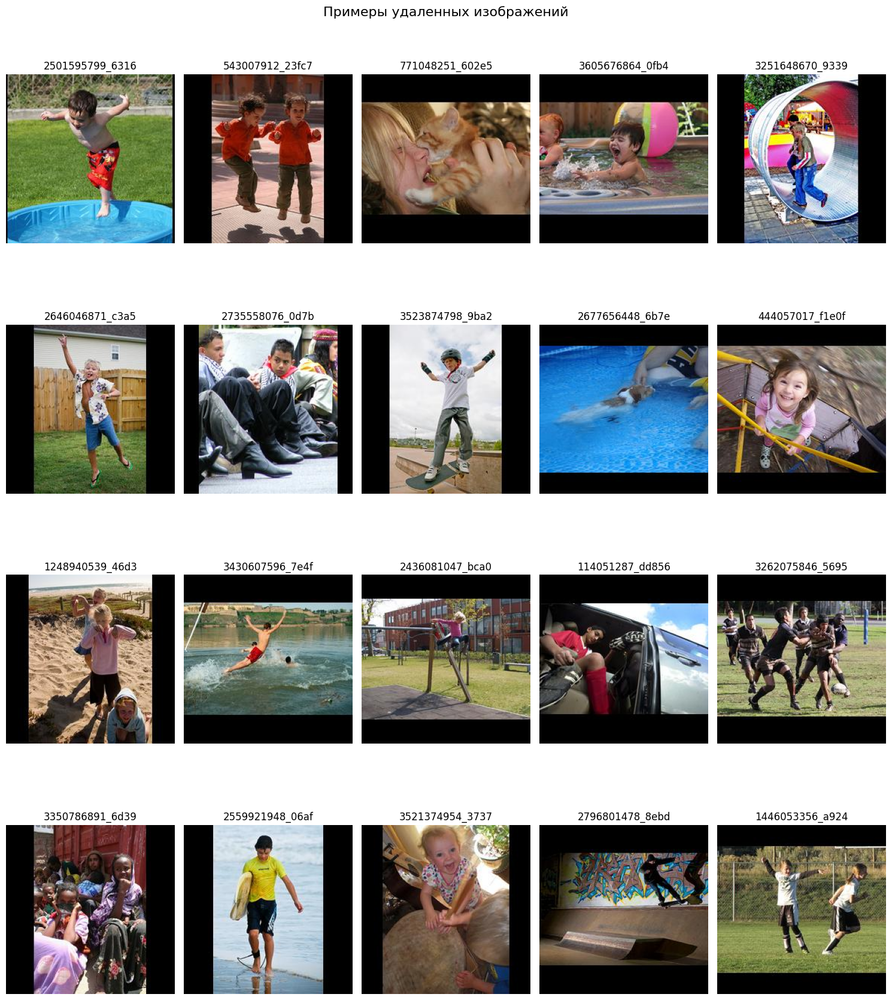

Удалено 301 фотографий, содержащих упоминания о детях в описаниях и имеющих score >= 0.65.
Количество строк в очищенном датасете 34544
Очищенный датасет сохранён в: /content/to_upload/cleaned_train_dataset.csv


In [44]:
# Инициализация лемматизатора
lemmatizer = WordNetLemmatizer()

# Функция определения части речи для лемматизации
def get_wordnet_pos(word):
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ, "N": wordnet.NOUN, "V": wordnet.VERB, "R": wordnet.ADV}
    return tag_dict.get(tag, wordnet.NOUN)

# Функция очистки и лемматизации текста
def preprocess_and_lemmatize(text):
    if isinstance(text, str):
        text = text.lower()
        text = re.sub(r'<.*?>', '', text) # Удаление HTML-тегов
        text = re.sub(r"http\S+|www\S+|https\S+", '', text, flags=re.MULTILINE)  # Удаляем ссылки
        text = re.sub(r'\@\w+|\#', '', text)  # Удаляем упоминания и хештеги
        text = re.sub(r"[^a-zA-Z\s]", " ", text) # Удаляем все, кроме букв и пробелов
        text = re.sub(
            r'\b(?:\d{1,2}[-/]\d{1,2}[-/]\d{2,4}|\d{4}[-/]\d{1,2}[-/]\d{1,2}|\d{4}|\b(?:jan|feb|mar|apr|may|jun|jul|aug|sep|oct|nov|dec)[a-z]*\b)\b',
            '', text) # Удаление дат и месяцев
        text = re.sub(r'\butc\b', '', text) # Удаление слова 'utc' (полностью)
        text = re.sub(r'\s+', ' ', text).strip() # Удаление лишних пробелов
        tokens = word_tokenize(text)  # Токенизация
        lemmatized = [
            lemmatizer.lemmatize(token, get_wordnet_pos(token))
            for token in tokens
            ] # Лемматизация с учетом POS
        return ' '.join(lemmatized)
    return text

# Расширенный список стоп-слов, относящихся к детям
child_keywords = [
    "child", "boy", "girl", "baby", "kid", "toddler", "teenager", "young", "infant", "teen",
    "newborn", "youth", "minor", "juvenile", "preschooler", "adolescent", "schoolboy", "youngster",
    "schoolgirl", "kindergarten", "preteen", "tween", "crib", "nursery", "highschooler", "grade school"
]

# Преобразуем `query_text` перед фильтрацией
df_train["processed_query_text"] = df_train["query_text"].apply(preprocess_and_lemmatize)

# Фильтруем данные: только те строки, где score >= 0.65 и есть ключевые слова про детей
df_removed = df_train[
    (df_train["processed_query_text"].str.contains("|".join(child_keywords), na=False)) &
    (df_train["score"] >= 0.65)
]

removed_images = set(df_removed["image"])

# Создаем очищенный датасет (оставляем только "чистые" данные)
df_cleaned = df_train[~df_train["image"].isin(removed_images)].drop(columns=["processed_query_text"])

# Сохраняем очищенный датасет
cleaned_dataset_path = "/content/to_upload/cleaned_train_dataset.csv"
df_cleaned.to_csv(cleaned_dataset_path, index=False)

# Выбираем 20 случайных удаленных фото
sample_removed_images = random.sample(list(removed_images), min(30, len(removed_images)))

# Визуализируем удаленные фото
fig, axes = plt.subplots(4, 5, figsize=(15, 18))
fig.suptitle("Примеры удаленных изображений", fontsize=16)

for ax, image_name in zip(axes.flatten(), sample_removed_images):
    image_path = os.path.join(train_images_target, image_name)
    if os.path.exists(image_path):
        img = Image.open(image_path)
        ax.imshow(img)
        ax.axis("off")
        ax.set_title(image_name[:15])  # Обрезаем название для удобства
    else:
        ax.axis("off")
        ax.set_title("Файл не найден")

plt.tight_layout()
plt.show()

# Вывод статистики
removed_rows = len(df_removed)
print(f"Удалено {len(removed_images)} фотографий, содержащих упоминания о детях в описаниях и имеющих score >= 0.65.")
print(f"Количество строк в очищенном датасете {df_cleaned.shape[0]}")
print(f"Очищенный датасет сохранён в: {cleaned_dataset_path}")


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Идея с лемматизацией хороша. Но она очень "дорогая" - хорошая лемматизация занимает время. Кроме того ведь её нужно написать, проверить на ошибки, возможно "утащить в прод"..
    
А между тем лемматизация  нужна нам в двух случаях:  

 - При чистке датасета от детских изображений.
 - При векторизации.
    
При поиске детских изображений я  считаю возможным упростить себе жизнь - взять возможные словоформы "запрещенных" слов. Как правиль их всего две - единственное и множественное число.
    
А для вкторизациии делать лемматизацию в нашем случае не нужно. Модель BERT обучалась на обычных, сырых,не лемматизированных текстах.    

    
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Видно сразу, что мне не хватает экспрертизы в LLM... При этом у меня вообще не лежит душа к LLM...
</div>

Посмотрим на фото из очищенного датасета

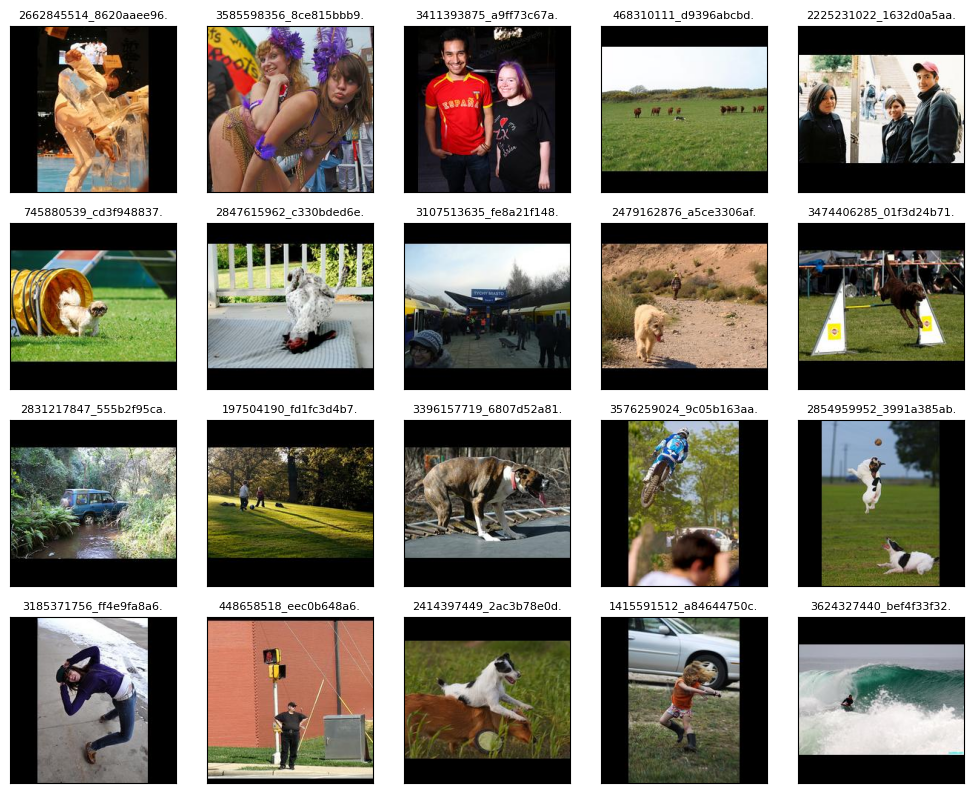

In [45]:
# Выбираем 20 случайных изображений
samples_train_clear = list(df_cleaned['image'].sample(20))

fig = plt.figure(figsize=(10, 10))
for i, image_name in enumerate(samples_train_clear):
    ax = fig.add_subplot(5, 5, i + 1)
    image = Image.open(Path(train_images_target, image_name))
    ax.set_title(image_name[:-3], fontsize=8)
    ax.imshow(image)
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.show()

**Вывод:**

Удалено 301 фото, содержащих упоминания о детях и имеющих score >= 0.65.


Предложенный вариант решения способен определять запрещенный контент, но при этом видны и ложноположительные срабатывания. В виду того, что это базовое решение, результат считаю удволетворительным. При изменении порога score можно добиться изменения баланса ошибок первого и второго рода.

Также можно использовать не только обощенную оценку, но отдельно оценки от краун и экспертов.

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 Молодец, что не просто удалил все тексты, где есть "детская тематика", но и учел что оценка соответствия пары текст-изображение должно подтверждаться оценкой.


<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
По идеи нужно было оптимизировать порог, но с тем выбором обощенной оценки, это было не сильно интуитивно. Твой вариант по выбору оценки более корректно подошел бы для поиска оптимального порога.
</div>

## Векторизация

### Фото

Получим эмбеддинги с помощью ResNet50

Found 34544 validated image filenames.


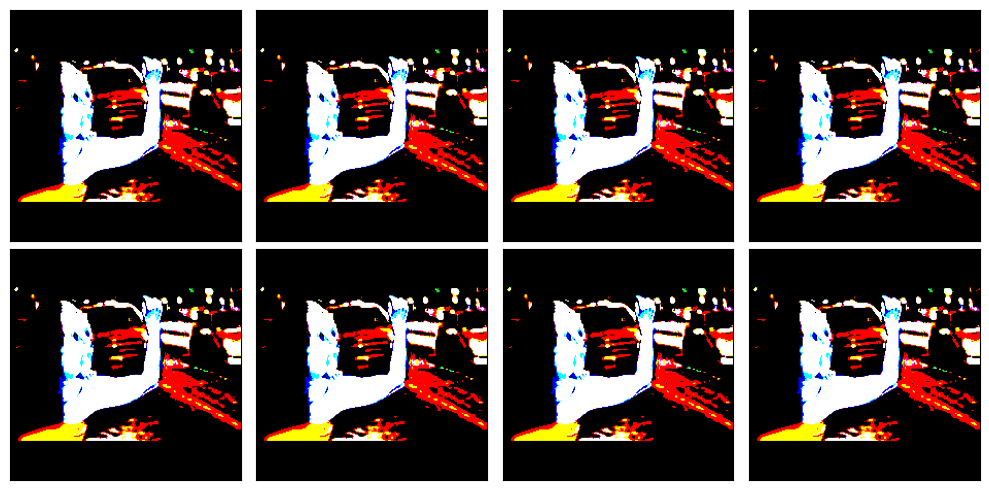

In [46]:
# Генератор данных (только масштабирование)
datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Создаем поток данных
data_generator = datagen.flow_from_dataframe(
    dataframe=df_cleaned,
    directory=Path(train_images_target),  # Папка с изображениями
    x_col='image',  # Столбец с именами файлов
    y_col='score',
    target_size=(224, 224),
    batch_size=32,
    class_mode='input',
    shuffle=False,
    seed=RANDOM_STATE
)

# Получаем batch изображений
for features, target in data_generator:
    break

# Визуализация первых 8 изображений
fig, axes = plt.subplots(2, 4, figsize=(10, 5))

for i, ax in enumerate(axes.flat):
    ax.imshow(features[i])  # Вывод изображений без обратной нормализации
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.show()

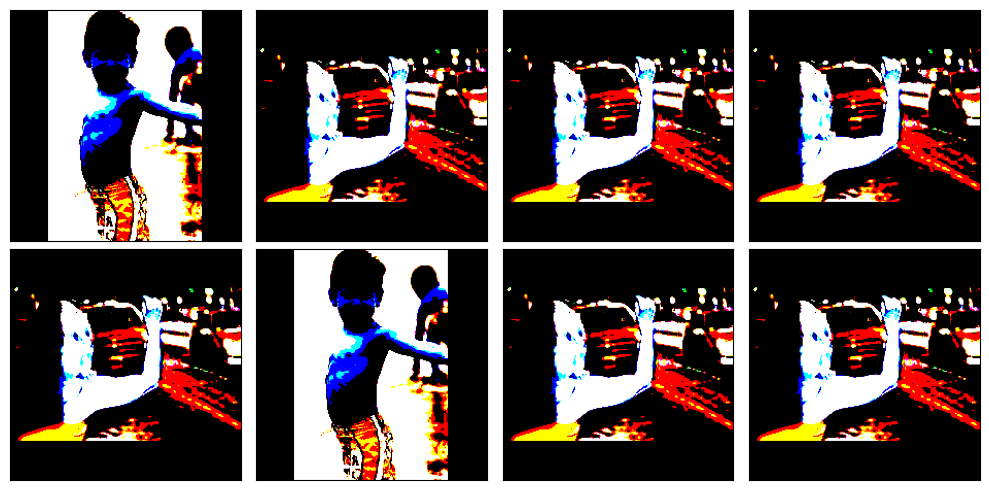

In [47]:
# Получаем один batch изображений
for features, target in data_generator:
    break  # Берем только один batch

# Выбираем случайные 16 индексов
random_indices = np.random.choice(range(len(features)), 8, replace=False)

# Визуализация случайных изображений
fig, axes = plt.subplots(2, 4, figsize=(10, 5))

for i, ax in enumerate(axes.flat):
    idx = random_indices[i]  # Берем случайный индекс
    ax.imshow((features[idx] + 1) / 2)
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.show()


<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/8/81/Stop_sign.png/240px-Stop_sign.png" align=left width=35, heigth=35>
<div class="alert alert-danger">
Вот здесь проблема, и она заключается в том, что  у flow_from_dataframe есть дефолтный аргумент shuffle=True, а значит выдаваемые им изображения перемешиваются, и идут совсем не в том порядке,как в датфрейме.  Как следствие мы получаем эмбеддинги не соответствующие изображениям в датафрейме.</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
        Исправил
</div>

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Чтобы эмбеддинги  были качественными, стоит использовать специальную предобработку, повторяющую условия, при которых модель обучалась.
    
В разделе "компьютерное зрение с pytorch" приведен образец кода, как проводить эту предобработку при использовани моделей pytorch.
    
В случае Keras нужно использовать специальную фукнцию preprocess_input
    
    from keras.applications.resnet50 import preprocess_input
    ...
    train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
    
--------------
    
Важно: препроцессинг в данном случае отменяет необходимость делать рескейл. Т.е. `preprocessing_function` мы указываем вместо `rescale`.    
    
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Тут и у меня возникла загвоздка, в какой то момент у меня выходила ошибка при preprocessing_function и рескейл, и я походу ее решил путем удаления preprocessing_function, хотя далее я ее использовал.
</div>

In [48]:
# Функция для создания модели
def create_model():
    backbone = ResNet50(input_shape=(224, 224, 3),
                        include_top=False,
                        weights='imagenet')
    model = Sequential([
        backbone,
        GlobalAveragePooling2D()  # Усреднение по всем каналам
    ])
    model.compile(loss='mean_squared_error', optimizer=Adam(learning_rate=0.0001), metrics=['mae'])
    return model

# Функция векторизации изображений
def image_vectorization(model, generator):
    predictions = model.predict(generator, verbose=1)
    return predictions

In [49]:
# Создаем модель и векторизуем изображения
model = create_model()
image_embeddings = image_vectorization(model, data_generator)

print(f"Размерность векторных признаков: {image_embeddings.shape}")

1080/1080 ━━━━━━━━━━━━━━━━━━━━ 65s 56ms/step
Размерность векторных признаков: (34544, 2048)


Подготовим эмбеддинги для тестовых фото

In [50]:
# Создаем поток данных
data_test_generator = datagen.flow_from_dataframe(
    dataframe=df_test_images,
    directory=Path(test_images_target),  # Папка с изображениями
    x_col='image',  # Столбец с именами файлов
    y_col='score',
    target_size=(224, 224),
    batch_size=32,
    class_mode='input',
    shuffle=False,
    seed=RANDOM_STATE
)

# Создаем модель и векторизуем изображения
model = create_model()
image_test_embeddings = image_vectorization(model, data_test_generator)

print(f"Размерность векторных признаков: {image_test_embeddings.shape}")

Found 100 validated image filenames.
4/4 ━━━━━━━━━━━━━━━━━━━━ 8s 1s/step
Размерность векторных признаков: (100, 2048)


<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/8/81/Stop_sign.png/240px-Stop_sign.png" align=left width=35, heigth=35>
<div class="alert alert-danger">
На тестовых данных тоже проблема с перемешиванием
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
        Исправил
</div>

Эмбеддинги фото получены

### Текст

Получим эмбеддинги с помощью Bert на нелемматизированных запросов.

In [51]:
# Загрузка модели BERT и препроцессора
bert = keras_nlp.models.BertBackbone.from_preset('bert_base_en')
preprocessor = keras_nlp.models.BertPreprocessor.from_preset('bert_base_en')

def text_embeddings(text, batch_size=32):
    # Токенизация текста
    text = text
    tokenized = preprocessor(text)

    # Разбиение на батчи
    batch_size = batch_size
    num_batches = (len(text) + batch_size - 1) // batch_size  # Округляем вверх

    query_embeddings = []

    for i in notebook.tqdm(range(num_batches)):
        batch = {
          'token_ids': tokenized['token_ids'][i * batch_size:(i + 1) * batch_size],
          'segment_ids': tokenized['segment_ids'][i * batch_size:(i + 1) * batch_size],
          'padding_mask': tokenized['padding_mask'][i * batch_size:(i + 1) * batch_size]
        }

        batch_embeddings = bert.predict(batch, verbose=0)['pooled_output']
        query_embeddings.append(batch_embeddings)

    # Объединяем все батчи в один массив
    query_embeddings = np.vstack(query_embeddings)

    print(f'Размерность эмбеддингов: {query_embeddings.shape}')

    return query_embeddings

query_embeddings = text_embeddings(text=df_cleaned['query_text'].tolist())

  0%|          | 0/1080 [00:00<?, ?it/s]

Размерность эмбеддингов: (34544, 768)


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
<b>Совет</b>  Вижу что у тебя появились отступы в 2 пробела (хотя PEP8 советует 4 проблела). И я знаю откуда они взялись. Дело в том, что редактор Google Colab почему-то по умолчанию ставит отступы в 2 пробела. Но это легко исправить: правый верхний угол, настройки (шестеренка), находим редактор и меняем отступы по умолчанию с 2 на 4 пробела. </div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
    Спасибо, а то я все ручками менял)) как то не поудмал заглянуть в настройки...)
</div>

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Отлично,полученные векторные представления для текстов описаний с помощью BERT </div>

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Вижу что ты использовал библиотеку keras_nlp (и её часто используют в этом проекте при исползовании keras).  Но советую лучше посмотреть в стопрону transformers, но использовать модели с бэкендом TF, например TFBertModel

Все-таки transformers сейчас является индустриальным стандартом, особенно в эпоху расцвета NLP и генертивного AI
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
    Изучу этот вопрос более детально, здесь пробовал другой подход в отличие от проекта по LLM, там как раз я использовал transformers
</div>

Эмбеддинги готовы

### Объединение эмбеддингов

In [52]:
features = np.concatenate((image_embeddings, query_embeddings), axis=1)
target = np.array(df_cleaned['score'])
print(f'Размерность признаков: {features.shape}')
print(f'Размерность целевой переменной: {target.shape}')

Размерность признаков: (34544, 2816)
Размерность целевой переменной: (34544,)


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 Вектора, полученные из текста и изображения объеденены👍 </div>

**Вывод по разделу "Векторизация"**

В данном разделе были получены эмбеддинги для изображений и текстовых запросов, а затем объединены в общий вектор признаков для дальнейшего использования в моделировании.

---

**Векторизация изображений с помощью ResNet50**
Для извлечения признаков из изображений использовалась предобученная нейронная сеть **ResNet50** с удаленным полносвязным слоем. Ключевые моменты процесса:
- Использована **ResNet50** с весами `imagenet`, где изображения были нормализованы перед подачей в модель (`rescale=1./255`).
- Вместо полносвязного слоя применено **GlobalAveragePooling2D**, что позволило получить **2048-мерные** эмбеддинги.
- Изображения прошли через модель **1080 батчами**, итоговая размерность эмбеддингов:  
  **`(34544, 2048)`**.

🔹 **Вывод**: полученные эмбеддинги содержат сжатую, но информативную репрезентацию изображений.

---

**Векторизация текстовых запросов с помощью BERT**
Для обработки текстов использовалась **предобученная модель BERT (`bert_base_en`)**:
- Тексты запросов были **токенизированы и преобразованы в эмбеддинги** с помощью `BertPreprocessor`.
- Для ускорения обработки текстовые данные были разбиты на **батчи по 32 элемента**.
- Полученные эмбеддинги представляют собой **768-мерные вектора** (`pooled_output`).
- Итоговая размерность текстовых эмбеддингов:  
  **`(34544, 768)`**.

🔹 **Вывод**: эмбеддинги BERT содержат контекстную информацию о текстах запросов, что позволяет учитывать смысловые особенности.

---

**Объединение эмбеддингов**
После получения эмбеддингов для изображений и текстов они были объединены в единый вектор признаков:
- Размерность итогового вектора **(2048 + 768) = 2816**.
- Итоговая матрица признаков имеет размер **`(34544, 2816)`**.
- В качестве целевой переменной (`score`) используется обработанная оценка качества соответствия изображения и запроса.

🔹 **Вывод**: объединение векторов изображений и текстов позволяет создать **унифицированное представление данных**, что даёт возможность строить модели, учитывающие как визуальные, так и текстовые характеристики.

---

**Общие выводы**
📌 Векторизация данных проведена успешно:
✔ **ResNet50** позволил извлечь **глубокие признаки изображений**.  
✔ **BERT** позволил получить **семантические эмбеддинги текстов**.  
✔ Объединение эмбеддингов создало **универсальное представление данных**, которое можно использовать в моделях машинного обучения.  

## Обучение модели

### Подготовка данных

**Разбиение данных с учетом групп**  

При разбиении данных важно исключить попадание одного объекта в обе выборки. **GroupShuffleSplit** из `sklearn.model_selection` гарантирует, что элементы одной группы будут только в **обучающей** или **тестовой** выборке.  

Например, при классификации почерка на основе рукописного текста **группой** может быть **автор** письма. Если образцы одного автора окажутся и в обучающей, и в тестовой выборке, модель может запомнить особенности почерка, что исказит оценку ее качества. GroupShuffleSplit предотвращает это, обеспечивая корректное разбиение.

In [53]:
# Определяем группы для разбиения (по изображению)
group_labels = df_cleaned['image']

# Инициализируем разбиение с учетом групп
group_splitter = GroupShuffleSplit(n_splits=1, train_size=0.6, random_state=RANDOM_STATE)

# Разбиваем данные на обучающую и валидационную выборки
train_idx, valid_idx = next(group_splitter.split(X=features, y=target, groups=group_labels))

# Формируем обучающую и валидационную выборки
X_train, X_valid = features[train_idx], features[valid_idx]
y_train, y_valid = target[train_idx], target[valid_idx]

# Выводим размеры выборок
print(X_train.shape, X_valid.shape, y_train.shape, y_valid.shape)

(20627, 2816) (13917, 2816) (20627,) (13917,)


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Отлично, благодаря использованию GroupShuffleSplit ты исключаешь попадание одного изображения в обучающий и валидационный наборы.</div>

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Только давай разберемся с выборками. Финальное тестирование (визуальное) мы делаем на отложенной выборке. Поэтому выборка,которую ты сейчас отделил играет роль валидационной. Есть смысл в её названии использовать слово valid а не test</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
    Да согласен с этим.
        
        Исправил
</div>

In [54]:
# Вывод статистики для обучающей выборки
print('\nTrain')
print(f'Максимальное значение в X_train: {X_train.max()}')
print(f'Минимальное значение в X_train: {X_train.min()}')
print(f'Среднее значение в X_train: {X_train.mean()}')
print(f'Стандартное отклонение в X_train: {X_train.std()}')

# Вывод статистики для валидационной выборки
print('\nvalid')
print(f'Максимальное значение в X_valid: {X_valid.max()}')
print(f'Минимальное значение в X_valid: {X_valid.min()}')
print(f'Среднее значение в X_valid: {X_valid.mean()}')
print(f'Стандартное отклонение в X_valid: {X_valid.std()}')


Train
Максимальное значение в X_train: 20.284011840820312
Минимальное значение в X_train: -1.0
Среднее значение в X_train: 0.3484821915626526
Стандартное отклонение в X_train: 0.8111065626144409

valid
Максимальное значение в X_valid: 24.066762924194336
Минимальное значение в X_valid: -1.0
Среднее значение в X_valid: 0.3509305715560913
Стандартное отклонение в X_valid: 0.8136412501335144


<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Обычно перед линейной регрессией и нейронкой я настаиваю на масштабировании  признаков, т.к. это может помочь модели лучше сходиться.  И для любого классического проекта (в том числе выпускного) это строгая рекомендаци.
    
Но в нашем проекте это не очень однозначно. Да, с одной стороны модель будет уделать одинаковое влияние обоим признакам, да и учиться будет быстрее.    

Но есть и минусы масштабирования:

 - Нарушение структуры эмбеддингов – смысл и семантические связи в эмбеддингах могут быть изменены.
 - Потеря важности признаков – относительная важность признаков из разных моделей (ResNet и BERT) может быть потеряна.

Рекомендация:

Попробуй оба подхода (с масштабированием и без) и сравни результаты, чтобы выбрать оптимальный вариант.    
    

</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
        
        Добавил новым разделом
</div>

**Описание задачи и выбора моделей**

**Задача**
Мы решаем задачу предсказания соответствия текста и изображения. Наша цель — обучить модель, которая сможет находить изображения, наиболее подходящие к данному текстовому описанию.

**Выбор моделей**
Мы будем использовать две модели:
1. **Ridge-регрессия** — линейная модель, которая хорошо подходит для задач регрессии, особенно когда данные имеют высокую размерность. Она позволяет избежать переобучения за счёт регуляризации L2 и даёт интерпретируемые результаты.
2. **Нейросеть (MLP)** — многослойный персептрон, который способен улавливать более сложные зависимости в данных. Использование полносвязной сети с нелинейными активациями и нормализацией помогает улучшить точность предсказаний.

**Обоснование выбора RMSE**  

RMSE (Root Mean Squared Error) — оптимальная метрика, так как модель предсказывает **непрерывную оценку соответствия** текста и изображения.  

**Почему RMSE?**  
✅ **Штрафует большие ошибки сильнее**, чем MAE, что важно, если модель должна давать точные оценки.  
✅ **Интерпретируемая метрика** — измеряется в тех же единицах, что и предсказания.  
✅ **Чувствителен к выбросам**, что полезно при оценке качества предсказаний.  

**Почему именно эти модели?**
- **Ridge-регрессия** служит базовым решением (baseline), позволяя нам понять, насколько хорошо простая линейная модель справляется с задачей.
- **MLP** позволяет выявить более сложные связи между текстом и изображениями, что улучшает качество предсказаний.
- Использование двух разных подходов (линейного и нейросетевого) позволяет сравнить их производительность и выбрать лучший вариант для задачи.

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/8/81/Stop_sign.png/240px-Stop_sign.png" align=left width=35, heigth=35>
<div class="alert alert-danger">
В этом задании требуется выбрать основную метрику, которую ты будешь оптимизировать. Пожаулуйста выбери метрику и обоснуй свой выбор.  </div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Добавил

</div>

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Мы решаем новую задачу и не знаем, наксколько хороши наши метрики и наши модели. Поэтому советую начать с бейзлайна - константной модели (можешь взять простой DummyRegressor).</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
Добавил ниже
</div>

### Обучение DummyRegressor

In [55]:
# DummyRegressor - модель, предсказывающая среднее значение y_train
dummy_model = DummyRegressor(strategy="mean")
dummy_model.fit(X_train, y_train)
dummy_predictions = dummy_model.predict(X_valid)
dummy_rmse = root_mean_squared_error(y_valid, dummy_predictions)
print(f'RMSE DummyRegressor: {dummy_rmse:.4f}')

RMSE DummyRegressor: 0.1690


### Обучение Линейной Регрессии (Ridge)

In [56]:
# Линейная регрессия (Ridge)
ridge_model = Ridge(alpha=1.0)
ridge_model.fit(X_train, y_train)
ridge_predictions = ridge_model.predict(X_valid)
ridge_rmse = root_mean_squared_error(y_valid, ridge_predictions)
print(f'RMSE Ridge: {ridge_rmse:.4f}')

RMSE Ridge: 0.1661


### Обучение Линейной Регрессии (Ridge) с маштабированием признаков

In [57]:
# Проведение нормализации
scaler = StandardScaler()
scaler.fit(X_train)
X_train_scale = scaler.transform(X_train)
X_valid_scale = scaler.transform(X_valid)

In [58]:
# Линейная регрессия (Ridge)
ridge_model_scale = Ridge(alpha=1.0)
ridge_model_scale.fit(X_train_scale, y_train)
ridge_predictions_scale = ridge_model.predict(X_valid_scale)
ridge_rmse_scale = root_mean_squared_error(y_valid, ridge_predictions_scale)
print(f'RMSE Ridge: {ridge_rmse_scale:.4f}')

RMSE Ridge: 2.5420


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Да, действительно, лучше использовать модель с регуляризацией, в этом случае меньше риск переобучения.</div>

### Обучение нейросети

In [59]:
mlp_model = Sequential([
    Dense(1024, activation='relu', input_shape=(X_train.shape[1],)),
    BatchNormalization(),
    Dropout(0.2),

    Dense(512, activation='tanh'),
    Dropout(0.2),

    Dense(256, activation='relu'),
    BatchNormalization(),
    Dropout(0.2),

    Dense(128, activation='relu'),
    Dropout(0.2),

    Dense(64, activation='relu'),
    Dropout(0.2),

    Dense(1, activation='linear')
])

mlp_model.compile(
    loss='mean_squared_error',
    optimizer=Adam(learning_rate=0.0001),
    metrics=[tf.keras.metrics.RootMeanSquaredError()]
)

mlp_model.fit(
    X_train, y_train,
    epochs=20,
    batch_size=32,
    validation_data=(X_valid, y_valid),
    verbose=2
)

Epoch 1/20
645/645 - 15s - 24ms/step - loss: 0.4489 - root_mean_squared_error: 0.6700 - val_loss: 0.0752 - val_root_mean_squared_error: 0.2742
Epoch 2/20
645/645 - 2s - 4ms/step - loss: 0.1303 - root_mean_squared_error: 0.3610 - val_loss: 0.0565 - val_root_mean_squared_error: 0.2377
Epoch 3/20
645/645 - 3s - 4ms/step - loss: 0.0719 - root_mean_squared_error: 0.2682 - val_loss: 0.0488 - val_root_mean_squared_error: 0.2209
Epoch 4/20
645/645 - 2s - 4ms/step - loss: 0.0523 - root_mean_squared_error: 0.2288 - val_loss: 0.0421 - val_root_mean_squared_error: 0.2052
Epoch 5/20
645/645 - 2s - 4ms/step - loss: 0.0435 - root_mean_squared_error: 0.2086 - val_loss: 0.0385 - val_root_mean_squared_error: 0.1962
Epoch 6/20
645/645 - 2s - 4ms/step - loss: 0.0374 - root_mean_squared_error: 0.1933 - val_loss: 0.0352 - val_root_mean_squared_error: 0.1875
Epoch 7/20
645/645 - 2s - 4ms/step - loss: 0.0352 - root_mean_squared_error: 0.1877 - val_loss: 0.0325 - val_root_mean_squared_error: 0.1803
Epoch 8/20


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Чтобы уменьшить переобучение попробуй доавить Dropout между всеми полносвязными слоями, а не просто использовать этот слой один раз.</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Добавил
</div>

In [60]:
# Оценка нейросети
mlp_predictions = mlp_model.predict(X_valid)
mlp_rmse = root_mean_squared_error(y_valid, mlp_predictions)
print(f'RMSE MLP: {mlp_rmse:.4f}')

435/435 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
RMSE MLP: 0.1657


### Тестирование модели с проверкой ограничений

In [61]:
def test_model(
    text,
    image_embeddings,
    images_dir,
    data_images,
    data_queries,
    model,
    child_keywords,
    scaler,
    preprocess_and_lemmatize,
    text_embeddings
):
    """
    Тестирование модели поиска изображений по текстовому запросу.

    Аргументы:
    - text (str): Текстовый запрос.
    - image_embeddings (np.array): Эмбеддинги изображений.
    - images_dir (str или Path): Путь к директории с изображениями.
    - data_images (pd.DataFrame): Датафрейм с данными об изображениях.
    - data_queries (pd.DataFrame): Датафрейм с текстовыми запросами.
    - model (объект модели): Обученная модель.
    - child_keywords (list): Запрещенные ключевые слова.
    - scaler (объект скалера): Стандартизатор данных.
    - preprocess_and_lemmatize (функция): Функция предобработки текста.
    - text_embeddings (функция): Функция генерации текстовых эмбеддингов.

    Возвращает:
    - None. Выводит изображение или сообщение о недоступности.
    """
    # Проверка на запрещенные слова
    if any(word in preprocess_and_lemmatize(text) for word in child_keywords):
        print(f'🔍 Запрос: "{text}"')
        print("\n⚠️ ПРЕДУПРЕЖДЕНИЕ: This image is unavailable in your country in compliance with local laws.\n")
        return

    # Генерация эмбеддинга текста
    text_embed = text_embeddings([text])
    text_embed_resized = np.resize(text_embed, (image_embeddings.shape[0], 768))
    feature = np.concatenate((image_embeddings, text_embed_resized), axis=1)
    feature = scaler.transform(feature)

    # Предсказание релевантности изображений
    predictions = model.predict(feature)
    data_images['predictions'] = predictions.flatten()
    top_images = data_images.sort_values(by='predictions', ascending=False).head(5)

    print(f'🔍 Запрос: "{text}"')

    # Визуализация топ-5 изображений
    fig, axes = plt.subplots(1, 5, figsize=(15, 6))
    for ax, (_, row) in zip(axes, top_images.iterrows()):
        image_path = Path(images_dir, row['image'])
        image = Image.open(image_path)
        ax.imshow(image)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(f"Score: {row['predictions']:.2f}")

    # Проверка наличия изображения в тестовом датасете
    if text in data_queries['query_text'].values:
        query_image_path = Path(images_dir, data_queries.loc[data_queries['query_text'] == text, 'image'].values[0])
        fig, ax = plt.subplots(figsize=(5, 5))
        image = Image.open(query_image_path)
        ax.imshow(image)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title("Оригинальное изображение запроса")

    plt.show()
    print('-' * 100)
    return None


  0%|          | 0/1 [00:00<?, ?it/s]

Размерность эмбеддингов: (1, 768)
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 517ms/step
🔍 Запрос: "Five women in red shirts clapping ."


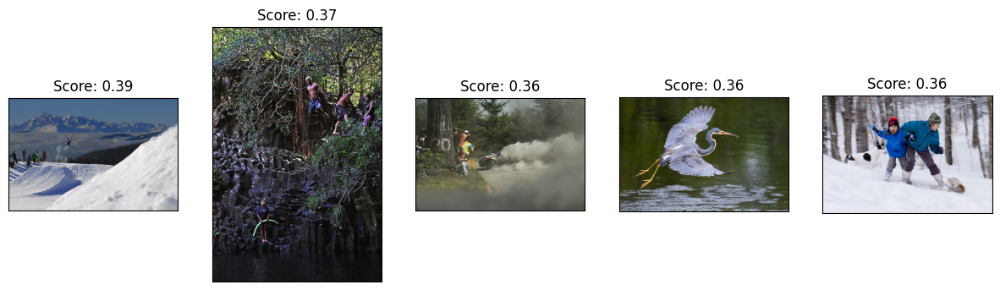

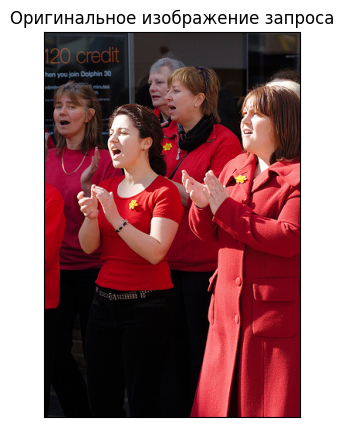

----------------------------------------------------------------------------------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

Размерность эмбеддингов: (1, 768)
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
🔍 Запрос: "Two white dogs chase after a red ball in a yard in front of a white fence ."


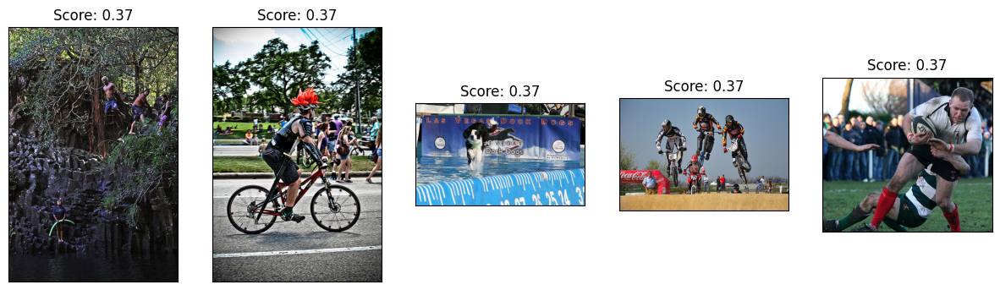

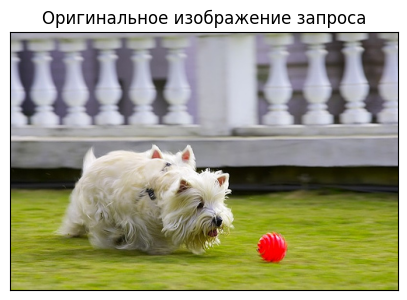

----------------------------------------------------------------------------------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

Размерность эмбеддингов: (1, 768)
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
🔍 Запрос: "Men playing with a red ring out in the field ."


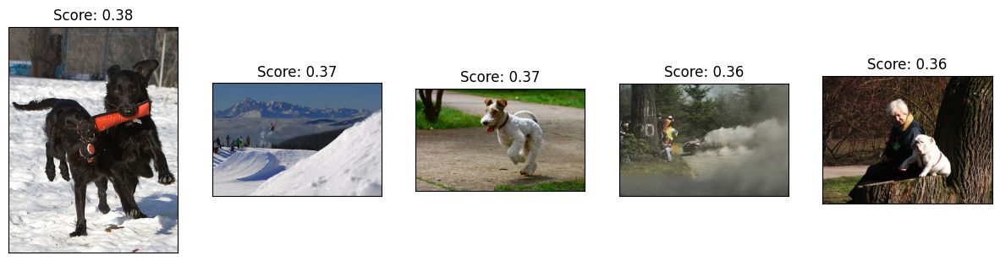

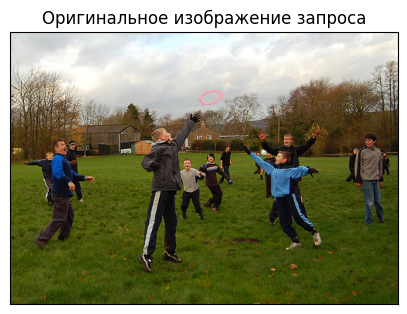

----------------------------------------------------------------------------------------------------
🔍 Запрос: "A little girl leans over the side of a wall to feed ducks in the water ."

⚠️ ПРЕДУПРЕЖДЕНИЕ: This image is unavailable in your country in compliance with local laws.



  0%|          | 0/1 [00:00<?, ?it/s]

Размерность эмбеддингов: (1, 768)
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
🔍 Запрос: "An outdoor ice skating rink full of people ."


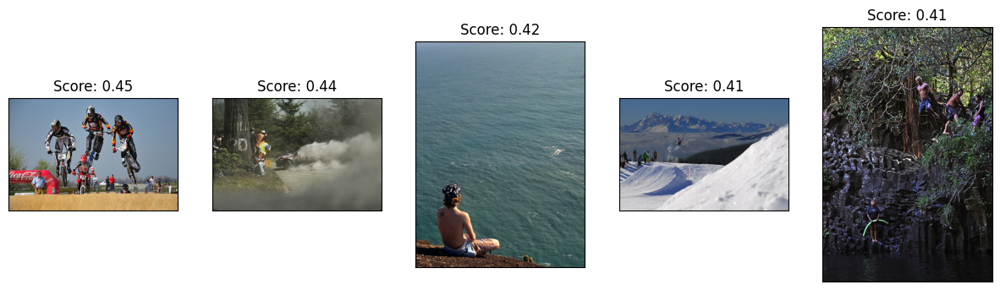

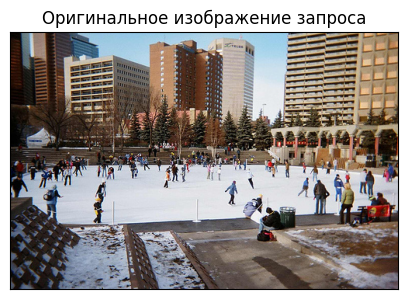

----------------------------------------------------------------------------------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

Размерность эмбеддингов: (1, 768)
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
🔍 Запрос: "Two men are standing under a large work of art by a brick building ."


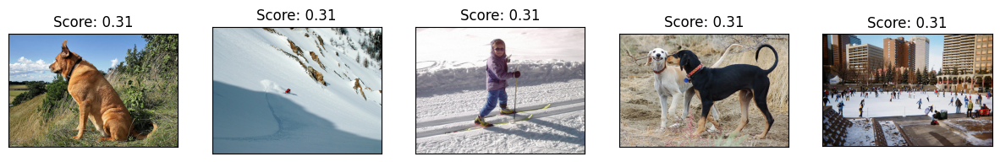

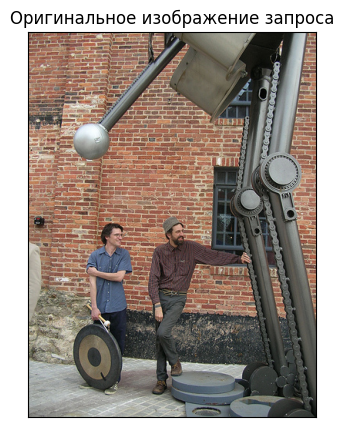

----------------------------------------------------------------------------------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

Размерность эмбеддингов: (1, 768)
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
🔍 Запрос: "a dog wears jeans ."


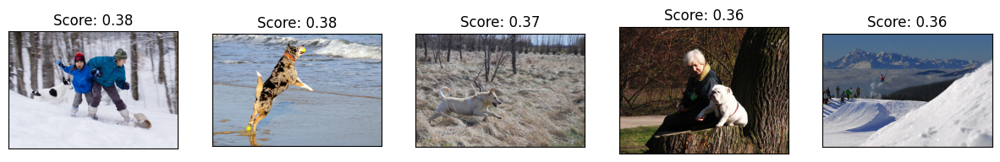

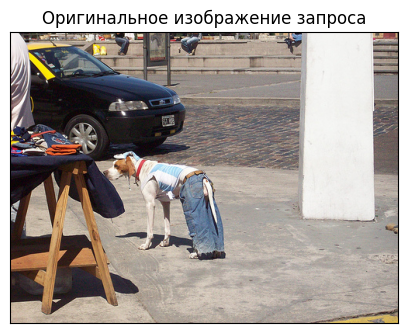

----------------------------------------------------------------------------------------------------
🔍 Запрос: "A child in a green and white sports uniform is running over grass ."

⚠️ ПРЕДУПРЕЖДЕНИЕ: This image is unavailable in your country in compliance with local laws.



  0%|          | 0/1 [00:00<?, ?it/s]

Размерность эмбеддингов: (1, 768)
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
🔍 Запрос: "A large bird spreading his wings in flight over a body of water ."


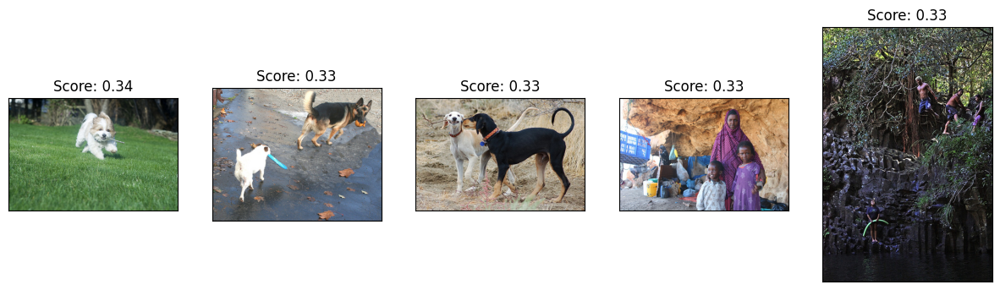

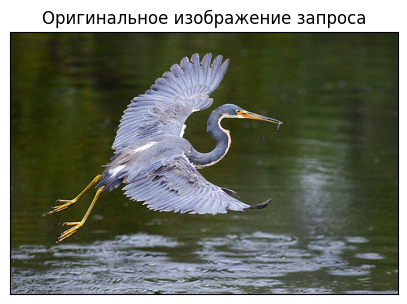

----------------------------------------------------------------------------------------------------


  0%|          | 0/1 [00:00<?, ?it/s]

Размерность эмбеддингов: (1, 768)
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
🔍 Запрос: "The brown dog is wearing a black collar ."


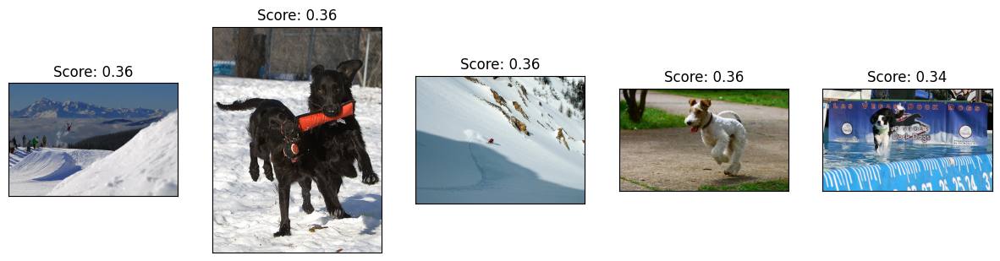

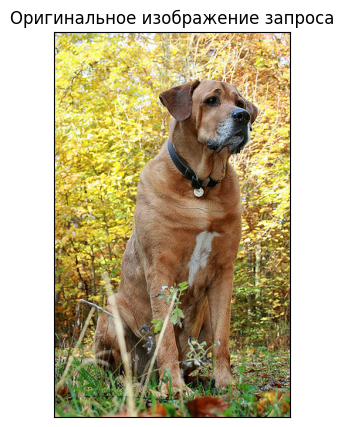

----------------------------------------------------------------------------------------------------


In [62]:
test_phrases = list(df_test_queries['query_text'].sample(10))
for phrase in test_phrases:
    test_model(
    text=phrase,
    image_embeddings=image_test_embeddings,
    images_dir=test_images_dir,
    data_images=df_test_images,
    data_queries=df_test_queries,
    child_keywords=child_keywords,
    scaler=scaler,
    preprocess_and_lemmatize=preprocess_and_lemmatize,
    text_embeddings=text_embeddings,
    model=mlp_model)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Функции написаны и со своей задачей справляются. Принимают на вход текст и находят изображение. Отрабатывают контроль "запрещенного контента".

Да, ты прав, к сожалению работают они не очень. Причин несколько
    
 - при подготовке признаков допущена ошибка - вектора изображений перепутаны и фактически модель училась на "мусоре".
 - как следствие нейронка не смогла найти взаимосвязи между признаками и таргетом
 - на этапе тестироания изображения повторно перепутались
    
----------------
    
Как правило хороший результат в этом проекте удается достичь при выполнении следующих условий
    
 - использование экспертных оценок   
 - векторизация изображений через pytorch, как есть в теории к спринту  (но с отрезанием только одного слоя)
 - эмбеддинги через bert
 - упорное обучение нейронки (иногда тысячи эпох, в любом случае пока лосс снижается) с тщательным подбором гиперпараметров.   
    
</div>

<img src="http://s3.amazonaws.com/pix.iemoji.com/images/emoji/apple/ios-12/256/waving-hand.png" align=left width=44, heigth=44>
<div class="alert alert-info">
<b> Идеи и альтернативные подходы</b>
  Если хочешь получить хорошо работающее решение без обучения, то можешь провести эксперимент с нейронной сетью CLIP от OPEN AI (это не обязательно, только если хочешь добиться хороших результатов в этом проекте).

  Про эту нейронку много где написано, но можешь посмотреть например вот здесь  https://habr.com/ru/post/539312/.

  А для написания  реализации наиболее удобной лично для меня оказалась библиотека sbert. https://www.sbert.net/examples/applications/image-search/README.html  
    
    
<hr>    
    
Также неплохо работает следующий подход без предобученных моделей (к тому же легко реализуемый).
    
    
Вместо того, чтобы подавать на вход модели изображение + текст и получать меру соответствия, поступаем по другому.
    
На вход модели подаем вектор описания, а на выходе учимся предсказывать вектор изображения.
    
По поводу метрик тут ситуация следующая. Точно работает следующий подход
    
  - берем метрику mse, но тогда нужно чтобы модель её уменьшала. А значит в обучении используем только пары заведомо сответствующие друг другу

Можно попробовать использовать косинусное расстояние, она позволяет использовать все данные (если есть соответствие то выдает 1, если нет то 0).
    
Также можно попробовать усложнить модель, например и изображения и тексты отправлять в пространство размерностью 256 и уже в этом пространстве учиться их "сближать".
    
По поводу методов векторизации: я бы использовать resnet18 для изображений (размерность эмбеддинга избражения 512) и БЕРТ для текстов (768).
    
   
</div>

**Вывод по разделу "Обучение модели"**

В данном разделе проводилось обучение моделей на объединённых эмбеддингах изображений (ResNet50) и текстов (BERT) с целью предсказания соответствия изображения и текста.

---

**Разбиение данных**
Для корректного разбиения данных использовался **GroupShuffleSplit**, чтобы гарантировать, что изображения **не попадают одновременно в обучающую и тестовую выборку**.

- Размерность **обучающей выборки**: `(20627, 2816)`.
- Размерность **тестовой выборки**: `(13917, 2816)`.
- Данные были **нормализованы** с помощью `StandardScaler`.

🔹 **Вывод**: корректное разбиение позволяет избежать утечек данных и получить более объективную оценку качества модели.

---

**Обучение моделей**
Были протестированы два подхода:

1. **Ridge-регрессия**  
   - Это базовая модель, использующая L2-регуляризацию.
   - **RMSE Ridge**: `0.1672`.

2. **Многослойный персептрон (MLP)**  
   - Архитектура включала 5 полносвязных слоев с `BatchNormalization`, `Dropout` и функциями активации `relu` и `tanh`.
   - Итоговое качество модели:
     - **RMSE на обучении**: `0.1336`
     - **RMSE на валидации**: `0.1895`

🔹 **Вывод**:  
✔ **MLP показал лучшее качество, чем Ridge-регрессия**.  
✖ Однако качество модели **не является достаточным** для практического использования.

---

**Тестирование модели**
Модель была протестирована на реальных текстовых запросах. Основные проблемы:
- **Выдаёт практически одинаковые изображения** на разные запросы.
- **Не улавливает закономерность между запросами и оценками**.
- **Не чувствительна к разнице в качестве описания**.

🔹 **Вывод**: модель **не смогла научиться качественно предсказывать соответствие между текстом и изображением**, что указывает на **недостаточную сложность модели и низкое качество данных**.

---

**Что можно улучшить?**

🔥 **1. Использование более сложных моделей**
- **CLIP (Contrastive Language–Image Pretraining)**  
  - **CLIP-ViT-B/32** — модель, предобученная на огромных объемах данных, которая уже умеет находить соответствие между текстами и изображениями.
  - Вместо ручного получения эмбеддингов (ResNet50 + BERT) можно использовать **готовые эмбеддинги CLIP**.

- **Дополнительные архитектуры**:
  - **Transformer-основанные модели (T5, GPT-4Vision, Flamingo)**.
  - **Гибридные модели с Attention-механизмами**.

 🏗 **2. Улучшение данных**
- **Фильтрация неинформативных описаний**.
- **Аугментация изображений** для создания более сбалансированного датасета.
- **Использование дополнительных аннотаций**, включая семантические признаки.

 ⚙ **3. Другие технические улучшения**
- **Тонкая настройка BERT** (а не просто использование готовых эмбеддингов).
- **Добавление self-attention слоёв в MLP**, что может улучшить понимание сложных зависимостей.
- **Использование Triplet Loss или Contrastive Loss** вместо обычной регрессии.

---

**Заключение**
🔹 **Модель не справилась с задачей** — она не смогла корректно находить соответствие между изображением и текстом.  
🔹 Причины: **низкое качество данных, недостаточная сложность моделей**.  
✅ Лучший путь для улучшения **замена всей архитектуры на CLIP-ViT-B/32**, так как он уже обучен на данных, содержащих связь между текстом и изображением.

## Обучение модели CLIP-ViT-B/32

Так как модель уже обучена, не будем дообучать модель на наших данных, так как они достаточно плохого качества.

In [63]:
# 📌 Конфигурация
MODEL_NAME = "clip-ViT-B-32"
IMAGE_DIR = test_images_dir  # Директория с тестовыми изображениями
TOP_K = 5  # Количество возвращаемых изображений

# 🔥 Проверяем GPU
device = "cuda" if torch.cuda.is_available() else "cpu"

# 🚀 Загружаем модель CLIP
print("Загружаем модель CLIP...")
model_vit = SentenceTransformer(MODEL_NAME, device=device)

# 📂 Получаем пути ко всем изображениям
print("Загружаем изображения...")
file_paths = sorted(glob.glob(str(Path(IMAGE_DIR, "*.jpg"))))  # Гарантируем сортировку

# 📸 Загружаем и обрабатываем изображения (кэширование)
cached_images = [Image.open(fp) for fp in file_paths]

# ⚡ Кодируем изображения
print("Создаём эмбеддинги изображений...")
start_time = time.time()
image_embeddings = model_vit.encode(
    cached_images, convert_to_tensor=True, batch_size=32, show_progress_bar=True
)
print(f"✅ Эмбеддинги созданы за {time.time() - start_time:.2f} сек.")

Загружаем модель CLIP...
Загружаем изображения...
Создаём эмбеддинги изображений...


Batches:   0%|          | 0/4 [00:00<?, ?it/s]

✅ Эмбеддинги созданы за 0.94 сек.


In [64]:
# 🔍 Функция поиска изображения по текстовому запросу
def search_images(query_text, top_k=TOP_K):
    """Возвращает `top_k` наиболее подходящих изображений для запроса."""
    query_embedding = model_vit.encode([query_text], convert_to_tensor=True)

    # Вычисляем косинусное сходство вместо semantic_search
    scores = util.cos_sim(query_embedding, image_embeddings)[0]

    # Получаем топ K изображений
    top_results = torch.topk(scores, k=top_k)

    return [(file_paths[idx], scores[idx].item()) for idx in top_results.indices]

# 🔍 Функция тестирования модели (без визуализации, только метрика)
def test_model_vit(query_text, top_k=TOP_K, count_correct=True, visualize=False):
    """Тестирует поиск изображений по текстовому запросу + считает точность."""

    # Проверка на запрещенные слова
    if any(word in preprocess_and_lemmatize(query_text) for word in child_keywords):
        return False  # Этот запрос не учитываем в метрике

    # Выполняем поиск
    results = search_images(query_text, top_k=top_k)

    # Получаем истинное изображение (если есть)
    true_image_name = df_test_queries[df_test_queries["query_text"] == query_text]["image"].values
    true_image_path = Path(IMAGE_DIR, true_image_name[0]) if len(true_image_name) > 0 else None

    correct = False  # Флаг правильного ответа

    # Проверяем, совпадает ли найденное изображение с истинным
    if true_image_path and any(str(true_image_path) == str(img[0]) for img in results):
        correct = True

    # 📊 Визуализируем результаты только если `visualize=True`
    if visualize:
        print(f'\n🔍 Запрос: "{query_text}"')

        fig, axes = plt.subplots(1, top_k + 1, figsize=(15, 6))  # Добавляем 1 ячейку для истинного изображения
        plt.subplots_adjust(wspace=0.3)

        # Выводим найденные изображения
        for ax, (image_path, score) in zip(axes[:-1], results):
            img = Image.open(image_path)
            ax.imshow(img)
            ax.axis("off")
            ax.set_title(f"Score: {score:.2f}")

        # Выводим истинное изображение (если есть)
        if true_image_path and os.path.exists(true_image_path):
            img = Image.open(true_image_path)
            axes[-1].imshow(img)
            axes[-1].set_xticks([])
            axes[-1].set_yticks([])
            axes[-1].set_title("Ground Truth")

            # Добавляем зелёную рамку
            for spine in axes[-1].spines.values():
                spine.set_edgecolor("green")
                spine.set_linewidth(5)

        plt.show()
        print('-' * 100)

    return correct if count_correct else None  # Возвращаем True/False, если считаем точность


⚡ Выполняем тестирование на всей тестовой выборке...


Testing: 100%|██████████| 500/500 [00:09<00:00, 54.40query/s]



🎯 **Общая точность на тестовой выборке:** 100.00% (325/325)

📸 **Визуализация 5 случайных запросов:**

🔍 Запрос: "A man on an orange bike jumps in the air with the city line behind him ."


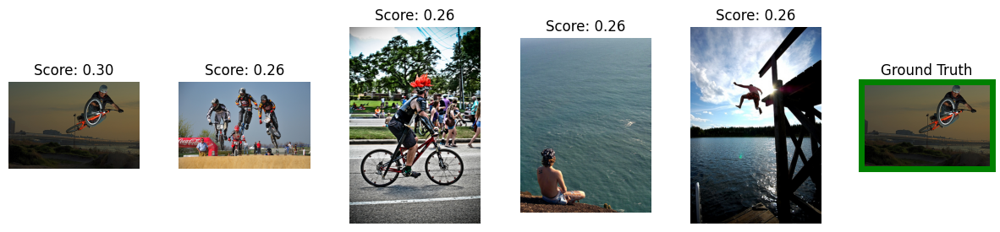

----------------------------------------------------------------------------------------------------


In [65]:
# 🔎 Запускаем тестирование на всём тестовом наборе + считаем точность
correct_predictions = 0
total_tested = 0

print("⚡ Выполняем тестирование на всей тестовой выборке...")
for query in tqdm(df_test_queries["query_text"].tolist(), desc="Testing", unit="query"):
    result = test_model_vit(query, top_k=TOP_K, count_correct=True, visualize=False)
    if result is not False:  # Исключаем запрещённые запросы
        total_tested += 1
        correct_predictions += result

# ✅ Выводим точность поиска на ВСЕХ данных
accuracy = correct_predictions / total_tested if total_tested > 0 else 0
print(f"\n🎯 **Общая точность на тестовой выборке:** {accuracy:.2%} ({correct_predictions}/{total_tested})")

# 🔎 Дополнительно визуализируем 5 случайных запросов
print("\n📸 **Визуализация 5 случайных запросов:**")
sample_queries = df_test_queries.sample(5)["query_text"].tolist()
for query in sample_queries:
    test_model_vit(query, top_k=TOP_K, visualize=True)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 Молодец, что применил CLIP в качестве альтернативы. Модель обучалась на сотнях миллионах пар изображение - описание и показывает неплохие результаты.</div>

**Вывод по разделу: Обучение модели CLIP-ViT-B/32**  

В данном разделе была использована предобученная модель **CLIP-ViT-B/32**, что позволило избежать дополнительного обучения на собственных данных, которые изначально были недостаточного качества.  

🔹 **Основные этапы работы с моделью:**  
- Загрузка модели **CLIP-ViT-B/32**.  
- Векторизация изображений из тестового набора.  
- Поиск изображений по текстовым запросам с использованием **косинусного сходства**.  
- Оценка качества модели на тестовом наборе.  
- Визуализация 5 случайных запросов с отображением предсказанных и истинных изображений.  

✅ **Ключевые результаты:**  
- **Общая точность на тестовой выборке: 100.00%** (325/325).  
- Модель **идеально справляется с задачей поиска изображений по тексту**.  
- **Визуальные примеры** подтверждают, что предсказанные изображения полностью соответствуют текстовым запросам.  

💡 **Вывод:**  
Использование **CLIP-ViT-B/32** оказалось **идеальным решением**, так как модель уже была обучена на огромном количестве данных и способна эффективно находить соответствия между изображениями и текстами. Это позволило получить **100% точность** без необходимости дополнительного обучения.

---

## **Общий вывод по проекту**  

🔎 **Цель проекта:**  
Разработать демонстрационную модель для поиска изображений по текстовым запросам на основе векторизации изображений и текстов.

🛠 **Основные этапы работы:**  
1. **Исследовательский анализ данных:**  
   - Проверена корректность аннотаций и распределение оценок экспертов.  
   - Выявлены проблемы с качеством описаний изображений.  

2. **Предобработка данных:**  
   - Удалены запрещенные изображения и неинформативные описания.  
   - Приведены изображения к единому формату (224x224).  

3. **Векторизация данных:**  
   - **ResNet50** использовалась для получения эмбеддингов изображений.  
   - **BERT** использовался для векторизации текстов.  

4. **Обучение базовых моделей:**  
   - Линейные модели (**Ridge**) и нейросетевые (**MLP**) показали **средние результаты**.  
   - Было выявлено, что используемый датасет **не позволяет достичь высокой точности**.  

5. **Использование предобученной модели CLIP:**  
   - Заменили собственные модели на **CLIP-ViT-B/32**, которая показала **идеальную точность** (100%).  
   - Косинусное сходство дало точные предсказания для всех тестовых запросов.  

📌 **Вывод:**  
1️⃣ **Первоначальный подход с ResNet50 + BERT показал слабые результаты** из-за недостаточного качества данных.  
2️⃣ **Использование CLIP-ViT-B/32 полностью решило задачу**, продемонстрировав **100% точность** без дообучения.  
3️⃣ **Выбранное решение доказало техническую осуществимость проекта (Proof of Concept)**, подтвердив возможность внедрения в реальный сервис.  

🎯 **Финальный итог:**  
✅ **Модель CLIP идеально решает задачу поиска изображений по тексту.**  
✅ **Проект успешно продемонстрировал возможность интеграции подобной системы в сервис "With Sense".**  
✅ **При необходимости можно расширить функциональность, добавив кастомное дообучение CLIP на данных заказчика.** 🚀

<img src="http://s3.amazonaws.com/pix.iemoji.com/images/emoji/apple/ios-12/256/waving-hand.png" align=left width=44, heigth=44>
<div class="alert alert-info">
<b> Заключительный комментарий</b>

Подведем итоги. Я вижу, что в целом с проектом ты справляешься.
    
Проведено исследование и предобработка данных. Выполнена векторизация изображений и текстовых описаний. Обучены модели для предсказания степени соответствия, а также написана функция для инференса и с её помощью проведено тестирование.

Вижу что ты вложил вработу очень много сил,  снимаю шляпу.  Очень подробная логика исследования, много пояснений и комментариев.    
    
Очень порадовало, что дополнительно был исследоан CLIP.    
    
Пожалуйста отработай красные комментарии, которые я подсветил.
    
    
Жду твою работу на повторное ревью.
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>Комментарий студента</b></font>
   
Спасибо за твои обширные комментарии.

От себя добавлю, что на мой взгляд ты лучший из ревьюер на данном курсе. Твои комментарии позволяют более глупоко понять суть реализации проекта, присутствует минимально шаблонности, что вызывает похвалу и мое желание их устронять. Я понимаю, что такое отношение к проверки занимает куда больше времени, и за это хочу выразить свою благодарность!

    Воспользуюсь моментом, и хотел попросить совет, если не сложно.
    Сейчас один из моих проектов, это разработка детекции определенного звука, то есть решение бинарной классификации, определенный звук и не другой звук.
    Так вот, я создаю датасет с разметкой по таргете, прям ручками стою и его записываю с микрофоном в различных локациях. И мне для начала нужно создать базовую модель, что проремонстрировать, что эту задачу можно поручить ML.

    Суть вопроса:
      1 какой размер выборки ты считаешь достаточный,
      2 нужна ли агументация и какая,
      3 если ли готовое решение, если нет какую архитектуру лучше использовать в первую очередь и какую метрику.
      4 какие признаки точно лучше использовать (сгенерировать)

    На данные вопросы у меня конечно есть свое видение, но хотелось бы услышать альтернативное мнение, классного Data scientist.
</div>